In [1]:
import json
import torch
import numpy as np
import random
import os
import pandas as pd
import sys
import random

sys.path.append('/home/vdhanraj/llama/llama3/llama')
sys.path.append('/home/vdhanraj/llama/llama3')

import openai
import requests
from requests.adapters import HTTPAdapter
from requests.packages.urllib3.util.retry import Retry

import time
from pathlib import Path
from typing import List, Optional, Tuple, TypedDict

import torch.nn.functional as F
from fairscale.nn.model_parallel.initialize import (
    get_model_parallel_rank,
    initialize_model_parallel,
    model_parallel_is_initialized,
)

from llama.model import ModelArgs, Transformer
from llama.tokenizer import ChatFormat, Dialog, Message, Tokenizer
from llama.generation import sample_top_p
from llama.EncoderNetworks import Encoder, Decoder, Encoder_Deep, Decoder_Deep

from typing import List, Optional
import fire

from llama import Dialog, Llama

from IPython.display import Markdown

import matplotlib.pyplot as plt

from sklearn.decomposition import PCA

import wandb

import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from llama.SP_engine import SemanticEngine
import plotly.graph_objects as go

from nengo.dists import UniformHypersphere

In [2]:
#ckpt_dir = "Meta-Llama-3-8B-Instruct"
ckpt_dir = "/home/vdhanraj/.llama/checkpoints/Llama3.1-8B-Instruct"
#tokenizer_path = "Meta-Llama-3-8B-Instruct/tokenizer.model"
tokenizer_path = "/home/vdhanraj/.llama/checkpoints/Llama3.1-8B-Instruct/tokenizer.model"
preprocess_24 = False
max_seq_len = 10000
max_batch_size = 2
model_parallel_size = 1

top_p = 0.9
temperature = 0
max_gen_len = None

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(torch.cuda.get_device_name(torch.cuda.current_device()))

NVIDIA GeForce RTX 4090


In [3]:
os.environ['RANK'] = "0"
os.environ['WORLD_SIZE'] = "1"
os.environ['MASTER_ADDR'] = "127.0.0.2"
os.environ['MASTER_PORT'] = "29502"
os.environ['LOCAL_RANK']  = "0"
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ['TORCH_USE_CUDA_DSA'] = '1'


generator = Llama.build(
    ckpt_dir=ckpt_dir,
    tokenizer_path=tokenizer_path,
    max_seq_len=max_seq_len,
    max_batch_size=max_batch_size,
)
self = generator

> initializing model parallel with size 1
> initializing ddp with size 1
> initializing pipeline with size 1


/home/vdhanraj/anaconda3/envs/torch/lib/python3.8/site-packages/torch/__init__.py:690: UserWarning: torch.set_default_tensor_type() is deprecated as of PyTorch 2.1, please use torch.set_default_dtype() and torch.set_default_device() as alternatives. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:451.)
  _C._set_default_tensor_type(t)


Loaded in 16.45 seconds


In [3]:
try:
    def episode(dialogs, temperature=0.0, top_p=0.9, inference_mode=self.model.forward, skip_weight=0.5):
        #print(dialogs)
        prompt_tokens = generator.parse_chat(dialogs)

        max_gen_len = self.model.params.max_seq_len - 1
        top_p = top_p
        echo = False

        params = self.model.params
        bsz = len(prompt_tokens)
        assert bsz <= params.max_batch_size, (bsz, params.max_batch_size)

        min_prompt_len = min(len(t) for t in prompt_tokens)
        max_prompt_len = max(len(t) for t in prompt_tokens)
        assert max_prompt_len <= params.max_seq_len
        total_len = min(params.max_seq_len, max_gen_len + max_prompt_len)

        pad_id = self.tokenizer.pad_id
        tokens = torch.full((bsz, total_len), pad_id, dtype=torch.long, device="cuda")
        for k, t in enumerate(prompt_tokens):
            tokens[k, : len(t)] = torch.tensor(t, dtype=torch.long, device="cuda")

        prev_pos = 0
        eos_reached = torch.tensor([False] * bsz, device="cuda")
        input_text_mask = tokens != pad_id

        stop_tokens = torch.tensor(list(self.tokenizer.stop_tokens))

        transitions = []
        num_tokens = 0
        list_of_probs = []
        h_stacks = []
        for cur_pos in range(min_prompt_len, total_len):
            logits, h_stack, h = inference_mode(tokens[:, prev_pos:cur_pos], prev_pos, skip_weight=skip_weight)
            h_stacks += [h_stack]
            # probs are intentionally being calculated here, so that it contains an extra token (the stop token), to help with loss calculation
            probs = torch.softmax(logits[:, -1] / 1, dim=-1)
            list_of_probs += [probs]
            new_logits = logits
            if temperature > 0:
                probs = torch.softmax(new_logits[:, -1] / temperature, dim=-1)
                #print(logits, logits.shape)
                next_token = sample_top_p(probs, top_p)
            else:
                next_token = torch.argmax(new_logits[:, -1], dim=-1)
            if num_tokens > 100: # Added to make sure answer is not too long, can remove later.
                next_token = stop_tokens[0]
            next_token = next_token.reshape(-1)
            # only replace token if prompt has already been generated
            next_token = torch.where(
                input_text_mask[:, cur_pos], tokens[:, cur_pos], next_token
            )
            tokens[:, cur_pos] = next_token

            eos_reached |= (~input_text_mask[:, cur_pos]) & (
                torch.isin(next_token, stop_tokens)
            )
            prev_pos = cur_pos
            if all(eos_reached):
                break

            #probs = torch.softmax(logits[:, -1] / 1, dim=-1)
            #list_of_probs += [probs]


            num_tokens += 1

        out_tokens = []
        for i, toks in enumerate(tokens.tolist()):
            # cut to max gen len
            start = 0 if echo else len(prompt_tokens[i])
            toks = toks[start : len(prompt_tokens[i]) + max_gen_len]
            # cut to after eos tok if any
            for stop_token in self.tokenizer.stop_tokens:
                try:
                    eos_idx = toks.index(stop_token)
                    toks = toks[:eos_idx]
                except ValueError:
                    pass
            out_tokens.append(toks)

        return h_stacks, list_of_probs, out_tokens
except:
    pass

In [4]:
def make_unitary(v):
    """
    Makes input unitary (Fourier components have magnitude of 1)
    """
    fv = np.fft.fft(v, axis=1)
    fv = fv/np.sqrt(fv.real**2 + fv.imag**2)
    return np.fft.ifft(fv, axis=1).real  

def make_tensor_unitary(v):
    """
    Makes input tensor unitary (Fourier components have magnitude of 1)
    """
    fv = torch.fft.fft(v, axis=1)
    fv = fv/torch.sqrt(fv.real**2 + fv.imag**2)
    return torch.fft.ifft(fv, axis=1).real

def invert(a, dim):
    """
    Inverts input under binding
    """
    return a[:,-torch.arange(dim)]

def identity(dim):
    """
    Returns
    -------
    np.array
        dim-D identity vector under binding
    """
    s = torch.zeros((1, dim), dtype=torch.float32)
    s[0][0] = 1
    return s

def null(shape):
    """
    Returns
    -------
    np.array
        dim-D null vector under binding
    """
    s = torch.zeros(shape, dtype=torch.float32)
    return s

def bind(a, b):
    """
    Binds together input using torch tensors.

    Parameters
    ----------
    a : torch.Tensor
        A tensor with shape (n_samples x ssp_dim)

    b : torch.Tensor
        A tensor with shape (n_samples x ssp_dim)

    Returns
    -------
    torch.Tensor
        A tensor with shape (n_samples x ssp_dim). Row i is a[i,:] bound with b[i,:]
    """
    ## Ensure the inputs are at least 2D (this behavior mimics np.atleast_2d)
    a = a.unsqueeze(0) if a.dim() == 1 else a
    b = b.unsqueeze(0) if b.dim() == 1 else b
    
    # Compute the FFT of both inputs along the last dimension
    fft_a = torch.fft.fft(a, dim=1)
    fft_b = torch.fft.fft(b, dim=1)

    # Multiply the FFTs element-wise
    fft_product = fft_a * fft_b

    # Perform the inverse FFT and take the real part of the result
    bound = torch.fft.ifft(fft_product, dim=1).real

    return bound



In [5]:
max_digits = 5 #15 # maximum representable number is 10**max_digits
SP_dim = 2048

SP_x = 0
SP_n1 = 1
SP_n2 = 2

possible_problems = ["addition", "multiplication", "division", "modulo", "gcd", "lcm", "square_mod", "bitwise_and", "bitwise_xor", "bitwise_or"]

SP_digit = 3 + len(possible_problems)

domain_size = 4 + len(possible_problems)



In [6]:
try:
    vectors         = torch.load(f"SP_vector_library_SPdim_{SP_dim}_domainSize_{domain_size}.pt")
    inverse_vectors = torch.load(f"SP_inverse_vector_library_SPdim_{SP_dim}_domainSize_{domain_size}.pt")
except Exception as e:
    print(e)
    torch.random.seed = 4
    vectors = torch.tensor(make_unitary(UniformHypersphere(surface=True).sample(domain_size,SP_dim)), dtype=torch.float32).cuda()
    for j in range(domain_size):
        q = vectors[j,:]/torch.linalg.norm(vectors[j,:])
        for k in range(j+1,domain_size):
            vectors[k,:] = vectors[k,:] - (q.T @ vectors[k,:]) * q
    vectors = make_tensor_unitary(vectors)
    inverse_vectors = invert(vectors, SP_dim).cuda()
    torch.save(vectors, f"SP_vector_library_SPdim_{SP_dim}_domainSize_{domain_size}.pt")
    torch.save(inverse_vectors, f"SP_inverse_vector_library_SPdim_{SP_dim}_domainSize_{domain_size}.pt")


In [7]:
digits = {"SP_" + str(10**(i-3-len(possible_problems))): i for i in range(3+len(possible_problems), 3+len(possible_problems)+max_digits)}

vocabulary = {
    "SP_x":    vectors[[SP_x]],
    "SP_n1":   vectors[[SP_n1]],
    "SP_n2":   vectors[[SP_n2]]}

for n, pt in enumerate(possible_problems):
    vocabulary[pt] = vectors[[len(vocabulary)]]

new_digit_tensors = []
for n, d in enumerate(digits):
    if n == 0:
        SP = vectors[[SP_digit]]
    else:
        SP = bind(SP, SP)
        new_digit_tensors += [SP.flatten()]
    vocabulary[d] = SP

vectors = torch.cat((vectors, torch.stack(new_digit_tensors)), dim=0)

vocabulary_inverse = {
    "SP_x":    inverse_vectors[[SP_x]],
    "SP_n1":   inverse_vectors[[SP_n1]],
    "SP_n2":   inverse_vectors[[SP_n2]]}

for n, pt in enumerate(possible_problems):
    vocabulary_inverse[pt] = inverse_vectors[[len(vocabulary_inverse)]]

new_digit_tensors = []
for n, d in enumerate(digits):
    if n == 0:
        SP = inverse_vectors[[SP_digit]]
    else:
        SP = bind(SP, SP)
        new_digit_tensors += [SP.flatten()]
    vocabulary_inverse[d] = SP

inverse_vectors = torch.cat((inverse_vectors, torch.stack(new_digit_tensors)), dim=0)

num_SP = identity(SP_dim).reshape(1, -1).cuda()
number_SPs = {}
number_SPs["0"] = num_SP
vocabulary["SP_number_" + str(0)] = num_SP
for i in range(1, 10):
    num_SP = bind(num_SP, vectors[SP_x])
    vocabulary["SP_number_" + str(i)] = num_SP
    number_SPs[str(i)] = num_SP


In [8]:
def generate_SP(num1, num2, problem_type="bitwise_xor"):
    nums1_coefs = [int(i) for i in list(str(num1))][::-1]
    nums2_coefs = [int(i) for i in list(str(num2))][::-1]

    total_SP1 = torch.zeros((1, SP_dim), dtype=torch.float32).cuda()
    for digit in range(len(nums1_coefs)):
        num_SP = identity(SP_dim).cuda()
        for i in range(nums1_coefs[digit]):
            num_SP = bind(num_SP, vectors[SP_x])
        #print("SP_" + str(10**digit), nums1_coefs[digit])
        num_SP = bind(num_SP, vocabulary["SP_" + str(10**digit)])

        total_SP1 += num_SP

    total_SP1 = bind(total_SP1, vectors[SP_n1])

    total_SP2 = torch.zeros((1, SP_dim), dtype=torch.float32).cuda()
    for digit in range(len(nums2_coefs)):
        num_SP = identity(SP_dim).cuda()
        for i in range(nums2_coefs[digit]):
            num_SP = bind(num_SP, vectors[SP_x])

        #print("SP_" + str(10**digit), nums2_coefs[digit])
        num_SP = bind(num_SP, vocabulary["SP_" + str(10**digit)])

        total_SP2 += num_SP

    total_SP2 = bind(total_SP2, vectors[SP_n2])

    final_SP = total_SP1 + total_SP2 + vocabulary[problem_type]

    return final_SP

num1, num2 = 3, 2
#num1, num2 = 38673028106, 6834025840
final_SP = generate_SP(num1, num2)

In [9]:
def decode_SP(SP, SP_n=None, similarity_threshold=0.5, T=0.01, exp_scalar=100, k=100):
    if SP_n:
        n = bind(SP, inverse_vectors[SP_n])
    else:
        n = SP

    query = bind(n, inverse_vectors[list(digits.values())])

    vs = (torch.stack(list(number_SPs.values())).reshape(-1, len(number_SPs), SP_dim) @ query.T)

    digit_values = torch.softmax(vs/T, dim=1)
    digit_scores = 1/exp_scalar*torch.log(torch.exp(vs*exp_scalar).sum(dim=1)) # LogSumExp
    digit_scores = torch.sigmoid(k * (digit_scores - similarity_threshold))
    modified_digit_values = digit_values * digit_scores.unsqueeze(1)

    exponents = torch.tensor([10**d for d in range(len(digits))], dtype=torch.float32)
    nums = torch.arange(0, 10, dtype=torch.float32).cuda()

    decoded_SPs = torch.stack([sum([(exponents[i] * torch.dot(nums.double(), modified_digit_values[j,:,i].double()))
                                    for i in range(digit_values.shape[2])])
                               for j in range(digit_values.shape[0])]).to(SP.device)

    return decoded_SPs

decode_SP(final_SP, SP_n1).item(), decode_SP(final_SP, SP_n2).item()

(3.000000000000022, 2.0000000000000004)

In [10]:
def single_digit_addition_fourier(n1, n2, n3, sum_terms=1000, epsilon=0.25):
    n = (n1 + n2 + n3 + epsilon).cuda()

    # Parameters
    batch_size = n.size(0)
    max_digit = 2 + 1
    sum_terms = sum_terms + 1

    # Prepare indices in a vectorized way
    k_values = torch.arange(1, sum_terms, dtype=torch.float32).view(1, 1, -1).cuda()  # Shape (1, 1, sum_terms - 1)
    d_values = torch.arange(max_digit, dtype=torch.float32).view(1, -1, 1).cuda()        # Shape (1, max_digit, 1)

    # Reshape n for broadcasting across digits and sum terms
    n = n.view(batch_size, 1, 1).cuda()  # Shape (batch, 1, 1)

    # Calculate A in a fully vectorized way
    A = torch.sin(2 * torch.pi * k_values * n / 10**d_values) / k_values  # Shape (batch, max_digit, sum_terms - 1)

    # Summations with the computed A, applied across the batch
    n_ones = torch.relu(4.5 + (1 / torch.pi) * (A[:, 0, :] - 10 * A[:, 1, :]).sum(dim=1))
    n_tens = torch.relu(4.5 + (1 / torch.pi) * (A[:, 1, :] - 10 * A[:, 2, :]).sum(dim=1))

    return n_ones, n_tens

# Make sure similarity_threshold is picked such that the correct number has a score greater than this threshold, and everything 
#  else is smaller than the threshold
def query_digit(SP, d, similarity_threshold=0.5, T=0.1, exp_scalar=100, k=100):
    query = bind(SP, inverse_vectors[digits[d]].cuda())

    vs = (torch.stack(list(number_SPs.values())).reshape(-1, len(number_SPs), SP_dim).cuda() @ query.T).T.squeeze(-1)

    digit_values = torch.softmax(vs/T, dim=1)
    digit_scores = 1/exp_scalar*torch.log(torch.exp(vs*exp_scalar).sum(dim=1)) # LogSumExp
    digit_scores = torch.sigmoid(k * (digit_scores - similarity_threshold))
    modified_digit_values = digit_values * digit_scores.unsqueeze(1)

    nums = torch.arange(0, 10, dtype=torch.float32).cuda()

    return (nums * modified_digit_values).sum(axis=-1)

def fractional_encode(x):
    return torch.fft.ifft((torch.fft.fft(vocabulary["SP_x"])**x.view(-1, 1))).real


def add_SP(SP, similarity_threshold=0.5):
    #SP = make_tensor_unitary(SP)

    n1 = bind(SP, vocabulary_inverse["SP_n1"].cuda())
    n2 = bind(SP, vocabulary_inverse["SP_n2"].cuda())

    n3 = null(SP.shape).cuda()
    r  = null((SP.shape[0])).cuda()
    for d in digits.keys():
        digit_n1 = query_digit(n1, d)
        digit_n2 = query_digit(n2, d)
        #print(d, digit_n1.item(), digit_n2.item(), r.item())

        digit_n3, r = single_digit_addition_fourier(digit_n1, digit_n2, r)
        #print(digit_n3.item(), r.item(), "\n")

        n3 += bind(vocabulary[d], fractional_encode(digit_n3))

    return n3

num1 + num2 - decode_SP(add_SP(final_SP.cuda())).item(), decode_SP(add_SP(final_SP.cuda())).item()

/tmp/ipykernel_22544/1630784189.py:30: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3637.)
  vs = (torch.stack(list(number_SPs.values())).reshape(-1, len(number_SPs), SP_dim).cuda() @ query.T).T.squeeze(-1)


(0.0, 5.0)

In [11]:
import math
def generate_dialog(complexity=8, samples=1, problem_type="addition"):
    x = np.random.randint(low=10**(complexity), high=10**(complexity+1), size=samples)
    y = np.random.randint(low=10**(complexity), high=10**(complexity+1), size=samples)

    example_x1, example_y1 = np.random.randint(low=10**(complexity), high=10**(complexity+1)), np.random.randint(low=10**(complexity), high=10**(complexity+1))
    example_x2, example_y2 = np.random.randint(low=10**(complexity), high=10**(complexity+1)), np.random.randint(low=10**(complexity), high=10**(complexity+1))
    example_x1, example_y1 = max(example_x1, example_y1), min(example_x1, example_y1)
    example_x2, example_y2 = max(example_x2, example_y2), min(example_x2, example_y2)

    dialog: List[Dialog] = []

    if type(problem_type) == type([]):
        problem_type = random.choice(problem_type)
    
    if problem_type == "random":
        problem_type = random.choice(["addition", "multiplication", "division", "modulo", "gcd", "lcm", "square_mod", "bitwise_and", "bitwise_xor", "bitwise_or"])

    for n in range(samples):
        dialog += [
            [
                {"role": "system", "content": "You are a math solving helper. Don't use any commas in your output, and always answer problems according to the format of previous answers."},
            ]
        ]

        x[n], y[n] = max(x[n], y[n]), min(x[n], y[n])
        if problem_type == "addition":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} plus {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1 + example_y1}"},
                {"role": "user", "content": f"What is {example_x2} plus {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2 + example_y2}"},
                {"role": "user", "content": f"What is {x[n]} plus {y[n]}?"},
            ]

        elif problem_type == "multiplication":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} times {example_y1} mod {10**(complexity+1)}?"},
                {"role": "assistant", "content": f"{(example_x1 * example_y1) % 10**(complexity+1)}"},
                {"role": "user", "content": f"What is {example_x2} times {example_y2} mod {10**(complexity+1)}?"},
                {"role": "assistant", "content": f"{(example_x2 * example_y2) % 10**(complexity+1)}"},
                {"role": "user", "content": f"What is {x[n]} times {y[n]} mod {10**(complexity+1)}?"},
            ]

        elif problem_type == "division":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} // {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1//example_y1}"},
                {"role": "user", "content": f"What is {example_x2} // {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2//example_y2}"},
                {"role": "user", "content": f"What is {x[n]} // {y[n]}?"},
            ]

        elif problem_type == "modulo":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} mod {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1 % example_y1}"},
                {"role": "user", "content": f"What is {example_x2} mod {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2 % example_y2}"},
                {"role": "user", "content": f"What is {x[n]} mod {y[n]}?"},
            ]

        elif problem_type == "gcd":
            dialog[n] += [
                {"role": "user", "content": f"What is the GCD of {example_x1} and {example_y1}?"},
                {"role": "assistant", "content": f"{np.gcd(example_x1, example_y1)}"},
                {"role": "user", "content": f"What is the GCD of {example_x2} and {example_y2}?"},
                {"role": "assistant", "content": f"{np.gcd(example_x2, example_y2)}"},
                {"role": "user", "content": f"What is the GCD of {x[n]} and {y[n]}?"},
            ]

        elif problem_type == "lcm":
            dialog[n] += [
                {"role": "user", "content": f"What is the LCM of {example_x1} and {example_y1} mod {10**(complexity+1)}?"},
                {"role": "assistant", "content": f"{np.lcm(example_x1, example_y1) % 10**(complexity+1)}"},
                {"role": "user", "content": f"What is the LCM of {example_x2} and {example_y2} mod {10**(complexity+1)}?"},
                {"role": "assistant", "content": f"{np.lcm(example_x2, example_y2) % 10**(complexity+1)}"},
                {"role": "user", "content": f"What is the LCM of {x[n]} and {y[n]} mod {10**(complexity+1)}?"},
            ]

        elif problem_type == "square_mod":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1}^2 mod {example_y1}?"},
                {"role": "assistant", "content": f"{(example_x1)**2 % example_y1}"},
                {"role": "user", "content": f"What is {example_x2}^2 mod {example_y2}?"},
                {"role": "assistant", "content": f"{(example_x2)**2 % example_y2}"},
                {"role": "user", "content": f"What is {x[n]}^2 mod {y[n]}?"},
            ]

        elif problem_type == "bitwise_and":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} AND {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1 & example_y1}"},
                {"role": "user", "content": f"What is {example_x2} AND {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2 & example_y2}"},
                {"role": "user", "content": f"What is {x[n]} AND {y[n]}?"},
            ]

        elif problem_type == "bitwise_xor":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} XOR {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1 ^ example_y1}"},
                {"role": "user", "content": f"What is {example_x2} XOR {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2 ^ example_y2}"},
                {"role": "user", "content": f"What is {x[n]} XOR {y[n]}?"},
            ]
        elif problem_type == "bitwise_or":
            dialog[n] += [
                {"role": "user", "content": f"What is {example_x1} OR {example_y1}?"},
                {"role": "assistant", "content": f"{example_x1 | example_y1}"},
                {"role": "user", "content": f"What is {example_x2} OR {example_y2}?"},
                {"role": "assistant", "content": f"{example_x2 | example_y2}"},
                {"role": "user", "content": f"What is {x[n]} OR {y[n]}?"},
            ]


    return dialog, x, y, problem_type


In [12]:
def decode_digits(SP, n=SP_n1, verbose=False):
    if n == 0: 
        n == SP_n1
    decoded_values = []
    for d in digits.keys():
        dv = (query_digit(bind(SP, inverse_vectors[n].cuda()), d).item())
        if verbose:
            print(d, '\t', round(dv, 3))
        decoded_values += [dv]
    return np.array(decoded_values)

def decode_digits_tensor(SP, SP_n=SP_n1):
    decoded_values = []
    for d in digits.keys():
        dv = query_digit(bind(SP, inverse_vectors[SP_n].cuda()), d)
        decoded_values += [dv]
    decoded_values = torch.stack(decoded_values).T    
    return decoded_values

def decode_problem_type(SP, verbose=False):
    problem_type_SPs = []
    for p in possible_problems:
        problem_type_SPs += [vocabulary[p].flatten()]
    problem_type_SPs = torch.stack(problem_type_SPs)
    problem_type_labels = [possible_problems[i] for i in (problem_type_SPs @ SP.T.float()).T.argmax(axis=1)]
    if verbose:
        print(problem_type_labels)
    return np.array(problem_type_labels)


def digit_error(predictions, labels):
    errors = []

    for prediction, label in zip(predictions, labels):
        # Convert prediction and label to strings for digit-wise comparison
        pred_str = str(prediction)
        label_str = str(label)

        # Align digits by value (right-align with padding on the left)
        max_length = max(len(pred_str), len(label_str))
        pred_str = pred_str.zfill(max_length)
        label_str = label_str.zfill(max_length)

        # Count incorrect digits
        incorrect_count = 0
        for pred_digit, label_digit in zip(pred_str, label_str):
            if pred_digit != label_digit:
                incorrect_count += 1

        # Append the error for this pair
        errors.append(incorrect_count)

    return errors


In [13]:
from torch.utils.data import Dataset
from torch.utils.data import DataLoader, RandomSampler

class Encoder(nn.Module):
    def __init__(self, layer_id, input_dim, output_dim, bias=False, dtype=torch.bfloat16):
        super().__init__()
        self.encoder_layer = nn.Linear(input_dim, output_dim, bias=bias, dtype=dtype)
        self.layer_id = layer_id

    def forward(self, x):
        out = self.encoder_layer(x)
        return out
class Decoder(nn.Module):
    def __init__(self, layer_id, input_dim, output_dim, bias=False, dtype=torch.bfloat16):
        super().__init__()
        self.decoder_layer = nn.Linear(input_dim, output_dim, bias=bias, dtype=dtype)
        self.layer_id = layer_id

    def forward(self, x):
        out = self.decoder_layer(x)
        return out

class Encoder_Deep(nn.Module):
    def __init__(self, layer_id, input_dim, output_dim, hidden_dim, bias=False, dtype=torch.bfloat16):
        super().__init__()
        self.encoder_layer_1 = nn.Linear(input_dim,  hidden_dim, bias=bias, dtype=dtype)
        self.encoder_layer_2 = nn.Linear(hidden_dim, output_dim, bias=bias, dtype=dtype)
        self.activation = nn.ReLU()
        self.layer_id = layer_id

    def forward(self, x):
        x   = self.activation(self.encoder_layer_1(x))
        out = self.encoder_layer_2(x)
        return out

class Decoder_Deep(nn.Module):
    def __init__(self, layer_id, input_dim, output_dim, hidden_dim, bias=False, dtype=torch.bfloat16):
        super().__init__()
        self.decoder_layer_1 = nn.Linear(input_dim,  hidden_dim, bias=bias, dtype=dtype)
        self.decoder_layer_2 = nn.Linear(hidden_dim, output_dim, bias=bias, dtype=dtype)
        self.activation = nn.ReLU()
        self.layer_id = layer_id

    def forward(self, x):
        x   = self.activation(self.decoder_layer_1(x))
        out = self.decoder_layer_2(x)
        return out

class EncoderDataset(Dataset):
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        sample = self.data[idx]
        label = self.labels[idx]
        if self.transform:
            sample = self.transform(sample)
        return sample, label



In [14]:
def gather_h_stacks(dialog_data):
    #response_data = []
    dialogs = dialog_data[0]
    x       = dialog_data[1]
    y       = dialog_data[2]
    problem_type = dialog_data[3]

    h_stack, list_of_probs, out_tokens = episode(dialogs, temperature=temperature,
                                                 inference_mode=self.model.forward, 
                                                 )
    
    # shape of h_stack is [num_layers, batch_size, num_tokens, hidden_dm]

    
    #try:
    #    output = np.array([self.tokenizer.decode(out_tokens[i]) for i in range(len(out_tokens))], dtype=int)
    #except:
    #    output = np.array([self.tokenizer.decode(out_tokens[i]) for i in range(len(out_tokens))])
    #    print("Can't convert to int:", output)

    #response_data += ["Model Guesses", output]
    #response_data += ["Correct Answer", x+y]
    
    correct_sps = []
    for n in range(len(x)):
        correct_sp   = generate_SP(x[n], y[n], problem_type).to(torch.bfloat16)
        correct_sps += [correct_sp.flatten()]
    correct_sps = torch.stack(correct_sps)
    
    return h_stack, correct_sps

def gather_sps(dialog_data):
    x       = dialog_data[1]
    y       = dialog_data[2]

    correct_sps = []
    for n in range(len(x)):
        correct_sp   = generate_SP(x[n], y[n]).to(torch.bfloat16)
        correct_sps += [correct_sp.flatten()]
    correct_sps = torch.stack(correct_sps)
    
    return correct_sps

In [15]:
train_data_rounds = 10000
test_data_rounds  = 100

save_frequency = 20

layer_numbers = torch.arange(0, 33)
#layer_numbers = torch.arange(12, 24)
complexity  = 2 #10 # Complexity of problems to ask, represented by number of digits + 1 (of x and y)
n_samples   = max_batch_size # should be less or equal to  than params.max_batch_size

problem_type = ["multiplication",  "modulo", "gcd", "lcm", "square_mod", "bitwise_and", "bitwise_xor", "bitwise_or"]

if type(problem_type) == type([]):
    problem_str = "_".join(problem_type)
else:
    problem_str = problem_type

save_dir = f"gathered_data_{complexity}_complexity_{train_data_rounds}_train_rounds_{test_data_rounds}_test_rounds_{problem_str}"

model_dim = 4096

tokens_to_keep = 3

In [16]:
import torch
import os
from torch.utils.data import DataLoader
import numpy as np

try:
    self
    run_data_collection = True
except:
    run_data_collection = False
    pass
if run_data_collection:
    # Set directory to save data
    os.makedirs(save_dir, exist_ok=True)

    h_stacks = []
    numbers  = []

    # Save data per round to avoid keeping it in memory
    for r in range(train_data_rounds+1):
        if not r % save_frequency and r:
            print("On Round Number:", r)
            numbers_stacked = torch.stack(numbers)
            h_stacked = torch.stack(h_stacks)
            h_stacked = h_stacked.view(-1, tokens_to_keep, self.model.params.dim, self.model.params.n_layers+1)
            torch.save(h_stacked, os.path.join(save_dir, f"h_stack_round_{r}.pt"))
            torch.save(numbers_stacked, os.path.join(save_dir, f"correct_sps_round_{r}.pt"))
            h_stacks = []
            numbers  = []
            if r == train_data_rounds:
                break

        # Generate dialog data and gather `h_stack` and `correct_sps`
        dialog_data = generate_dialog(complexity=complexity, samples=n_samples, problem_type=problem_type)
        h_stack, correct_sps = gather_h_stacks(dialog_data)
        # shape of h_stack[0] is n_layers, batch, num_tokens, hiddem_dim. Len of it the number of output tokens
        h_stacks += [h_stack[0][:,:,-tokens_to_keep:,:,].permute((1, 2, 3, 0))] 
        # shape of h_stacks[-1] is batch, num_tokens, hiddem_dim, n_layers. len of it is number of runs
        numbers += correct_sps

    print("Training data gathering completed and saved to disk.")

    # Save data per round to avoid keeping it in memory
    for r in range(test_data_rounds+1):
        if not r % 10 and r:
            print("On Round Number:", r)
            numbers_stacked = torch.stack(numbers)
            h_stacked = torch.stack(h_stacks)
            h_stacked = h_stacked.view(-1, tokens_to_keep, self.model.params.dim, self.model.params.n_layers+1)
            torch.save(h_stacked, os.path.join(save_dir, f"testing_h_stack_round_{r}.pt"))
            torch.save(numbers_stacked, os.path.join(save_dir, f"testing_correct_sps_round_{r}.pt"))
            h_stacks = []
            numbers  = []
            if r == test_data_rounds:
                break

        # Generate dialog data and gather `h_stack` and `correct_sps`
        dialog_data = generate_dialog(complexity=complexity, samples=n_samples, problem_type=problem_type)
        h_stack, correct_sps = gather_h_stacks(dialog_data)
        h_stacks += [h_stack[0][:,:,-tokens_to_keep:,:,].permute((1, 2, 3, 0))] 
        numbers += correct_sps

    print("Testing data gathering completed and saved to disk.")


In [17]:
training_batch_size = 512

In [18]:
# Load data for each layer to create data loaders
encoder_data_loaders = []

restrict_training_dataset = None # Can set this to less than the total number of runs
for n_layer in layer_numbers:
    h_layer_data = []
    correct_sps_data = []

    # Load each round's data from disk
    if restrict_training_dataset:
        runs = restrict_training_dataset
    else:
        runs = train_data_rounds
    for r in range(runs+1):#data_gathering_rounds):
        if not r % save_frequency and r:
            h_stack = torch.load(os.path.join(save_dir, f"h_stack_round_{r}.pt"))
            correct_sps = torch.load(os.path.join(save_dir, f"correct_sps_round_{r}.pt"))

            # Collect data for the specific layer
            h_layer_data.append(h_stack[:, -1, :, n_layer])
            correct_sps_data.append(correct_sps)

    # Stack data for the current layer
    h_layer_stacked = torch.cat(h_layer_data, dim=0)
    numbers_stacked = torch.cat(correct_sps_data, dim=0)

    # Create `EncoderDataset` and `DataLoader` for the current layer
    encoder_training_data = EncoderDataset(h_layer_stacked.cuda(), numbers_stacked.cuda())
    gpu_generator = torch.Generator(device='cuda')
    gpu_generator.manual_seed(42)

    encoder_data_loader = DataLoader(
        encoder_training_data,
        batch_size=training_batch_size,
        shuffle=True,
        #generator=gpu_generator,
    )
    encoder_data_loaders.append(encoder_data_loader)

testing_encoder_data_loaders = []
for n_layer in layer_numbers:
    h_layer_data = []
    correct_sps_data = []

    # Load each round's data from disk
    for r in range(test_data_rounds+1):#data_gathering_rounds):
        if not r % save_frequency and r:
            h_stack = torch.load(os.path.join(save_dir, f"testing_h_stack_round_{r}.pt"))
            correct_sps = torch.load(os.path.join(save_dir, f"testing_correct_sps_round_{r}.pt"))

            # Collect data for the specific layer
            h_layer_data.append(h_stack[:, -1, :, n_layer])
            correct_sps_data.append(correct_sps)

    # Stack data for the current layer
    h_layer_stacked = torch.cat(h_layer_data, dim=0)
    numbers_stacked = torch.cat(correct_sps_data, dim=0)

    # Create `EncoderDataset` and `DataLoader` for the current layer
    testing_encoder_data = EncoderDataset(h_layer_stacked.cuda(), numbers_stacked.cuda())
    gpu_generator = torch.Generator(device='cuda')
    gpu_generator.manual_seed(42)

    test_encoder_data_loader = DataLoader(
        testing_encoder_data,
        batch_size=training_batch_size,
        shuffle=False,
        #generator=gpu_generator,
    )
    testing_encoder_data_loaders.append(test_encoder_data_loader)

print("Data loaders for each layer have been created.")

Data loaders for each layer have been created.


In [19]:
encoders = torch.nn.ModuleList()
for layer_id in layer_numbers:
    #layer_encoder = Encoder_Deep(layer_id, model_dim, SP_dim, model_dim*4).to(device)
    layer_encoder = Encoder(layer_id, model_dim, SP_dim, ).to(device)
    encoders.append(layer_encoder)#, dtype=torch.float32))


In [20]:
def count_trainable_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
count_trainable_parameters(layer_encoder)

8388608

In [21]:
training_epochs = 10000


In [22]:
learning_rate = 1e-3 # Base learning rate, modified by learning_rate_reduction_factors
learning_rate_reduction_factors = {25: 0.5, 50:  0.5, 100: 0.1, 250: .4}
learning_rate_reduction_factors = {50: 0.5, 100:  0.5, 250: 0.1, 500: .4}


In [23]:
optimizers   = [optim.Adam(encoders[n].parameters(), lr=learning_rate) for n in range(len(layer_numbers))]
criterion = nn.MSELoss()
losses = np.zeros((len(layer_numbers), training_epochs))
running_losses = np.zeros((len(layer_numbers)))
for i in range(training_epochs):
    if i in learning_rate_reduction_factors.keys():
        for param_group in optimizers[n].param_groups:
            param_group['lr'] = param_group['lr'] * learning_rate_reduction_factors[i]  # Set new learning rate
            print("Learning Rate changed to:", param_group['lr'])

    if not i % 1 and i:
        print("Epoch:", i, "Running Loss:", running_losses.mean(), f"\tTotal gradient norm: {total_norm}")
    for n, n_layer in enumerate(layer_numbers):
        encoders[n].train()
        running_loss = 0
        total_norm = 0.0
        for batch_idx, (data, labels) in enumerate(encoder_data_loaders[n]):
            model_pred = encoders[n](data)
            loss = torch.sqrt(criterion(model_pred, labels))
            loss.backward()
            tn = 0
            for p in encoders[n].parameters():
                if p.grad is not None:
                    param_norm = p.grad.data.norm(2)
                    tn += param_norm.item() ** 2
            total_norm += tn ** 0.5
            optimizers[n].step()
            optimizers[n].zero_grad()
            running_loss += loss.item()
        running_loss /= (batch_idx + 1)
        running_losses[n] = running_loss
        total_norm   /= (batch_idx + 1)
        losses[n][i] = running_loss


Epoch: 1 Running Loss: 0.11067393909801136 	Total gradient norm: 1.03818359375
Epoch: 2 Running Loss: 0.0625067508581913 	Total gradient norm: 0.522119140625
Epoch: 3 Running Loss: 0.05550823789654356 	Total gradient norm: 0.63896484375
Epoch: 4 Running Loss: 0.05216998475970644 	Total gradient norm: 0.79453125
Epoch: 5 Running Loss: 0.04998113458806818 	Total gradient norm: 0.8880859375
Epoch: 6 Running Loss: 0.04841521292021781 	Total gradient norm: 0.9578125
Epoch: 7 Running Loss: 0.0472759824810606 	Total gradient norm: 1.028515625
Epoch: 8 Running Loss: 0.04629026470762311 	Total gradient norm: 1.0892578125
Epoch: 9 Running Loss: 0.04522214947324811 	Total gradient norm: 1.11962890625
Epoch: 10 Running Loss: 0.0445819276751894 	Total gradient norm: 1.095703125
Epoch: 11 Running Loss: 0.043859308416193184 	Total gradient norm: 1.1595703125
Epoch: 12 Running Loss: 0.04328234123461174 	Total gradient norm: 1.1544921875
Epoch: 13 Running Loss: 0.04277306758996212 	Total gradient norm:

Epoch: 104 Running Loss: 0.033239006273674244 	Total gradient norm: 0.487255859375
Epoch: 105 Running Loss: 0.033166318951231066 	Total gradient norm: 0.496630859375
Epoch: 106 Running Loss: 0.03317741625236743 	Total gradient norm: 0.48330078125
Epoch: 107 Running Loss: 0.033145326556581436 	Total gradient norm: 0.486962890625
Epoch: 108 Running Loss: 0.03313247218276515 	Total gradient norm: 0.46572265625
Epoch: 109 Running Loss: 0.03314597389914773 	Total gradient norm: 0.482275390625
Epoch: 110 Running Loss: 0.03307032729640152 	Total gradient norm: 0.48232421875
Epoch: 111 Running Loss: 0.0330465605764678 	Total gradient norm: 0.477734375
Epoch: 112 Running Loss: 0.03305969238281249 	Total gradient norm: 0.487646484375
Epoch: 113 Running Loss: 0.03300032182173295 	Total gradient norm: 0.466796875
Epoch: 114 Running Loss: 0.03298090154474431 	Total gradient norm: 0.487109375
Epoch: 115 Running Loss: 0.032965550278172356 	Total gradient norm: 0.4900390625
Epoch: 116 Running Loss: 0.

Epoch: 205 Running Loss: 0.032003136837121214 	Total gradient norm: 0.4671875
Epoch: 206 Running Loss: 0.03204946806936554 	Total gradient norm: 0.486279296875
Epoch: 207 Running Loss: 0.032028336958451704 	Total gradient norm: 0.479345703125
Epoch: 208 Running Loss: 0.032034902861624054 	Total gradient norm: 0.477685546875
Epoch: 209 Running Loss: 0.032048080906723495 	Total gradient norm: 0.46943359375
Epoch: 210 Running Loss: 0.03200221206202651 	Total gradient norm: 0.497021484375
Epoch: 211 Running Loss: 0.03208701393821023 	Total gradient norm: 0.47666015625
Epoch: 212 Running Loss: 0.03199324174360795 	Total gradient norm: 0.478271484375
Epoch: 213 Running Loss: 0.03196531353574811 	Total gradient norm: 0.478173828125
Epoch: 214 Running Loss: 0.03197548606178977 	Total gradient norm: 0.501025390625
Epoch: 215 Running Loss: 0.03195569587476326 	Total gradient norm: 0.490966796875
Epoch: 216 Running Loss: 0.031970769708806815 	Total gradient norm: 0.474755859375
Epoch: 217 Running

Epoch: 305 Running Loss: 0.03140841397372159 	Total gradient norm: 0.141552734375
Epoch: 306 Running Loss: 0.03143028490471118 	Total gradient norm: 0.14400634765625
Epoch: 307 Running Loss: 0.03143541740648674 	Total gradient norm: 0.1431640625
Epoch: 308 Running Loss: 0.03142353404651989 	Total gradient norm: 0.14312744140625
Epoch: 309 Running Loss: 0.03139468106356534 	Total gradient norm: 0.1447265625
Epoch: 310 Running Loss: 0.03136212898023201 	Total gradient norm: 0.147265625
Epoch: 311 Running Loss: 0.031376555471709276 	Total gradient norm: 0.14427490234375
Epoch: 312 Running Loss: 0.03139537464488637 	Total gradient norm: 0.1467041015625
Epoch: 313 Running Loss: 0.031392600319602275 	Total gradient norm: 0.14544677734375
Epoch: 314 Running Loss: 0.031401524399266106 	Total gradient norm: 0.14410400390625
Epoch: 315 Running Loss: 0.03137428977272727 	Total gradient norm: 0.14453125
Epoch: 316 Running Loss: 0.031400229714133525 	Total gradient norm: 0.14161376953125
Epoch: 317

Epoch: 404 Running Loss: 0.031131351355350376 	Total gradient norm: 0.14649658203125
Epoch: 405 Running Loss: 0.031127698493726326 	Total gradient norm: 0.14449462890625
Epoch: 406 Running Loss: 0.031170746774384465 	Total gradient norm: 0.14412841796875
Epoch: 407 Running Loss: 0.03111905184659091 	Total gradient norm: 0.1427734375
Epoch: 408 Running Loss: 0.031165799227627838 	Total gradient norm: 0.1470947265625
Epoch: 409 Running Loss: 0.03110064882220644 	Total gradient norm: 0.14715576171875
Epoch: 410 Running Loss: 0.031112347227154356 	Total gradient norm: 0.1412841796875
Epoch: 411 Running Loss: 0.03113481926195549 	Total gradient norm: 0.14461669921875
Epoch: 412 Running Loss: 0.031110405199455494 	Total gradient norm: 0.14521484375
Epoch: 413 Running Loss: 0.031139720569957386 	Total gradient norm: 0.14368896484375
Epoch: 414 Running Loss: 0.031166908957741473 	Total gradient norm: 0.14361572265625
Epoch: 415 Running Loss: 0.03112543279474432 	Total gradient norm: 0.14616699

Epoch: 502 Running Loss: 0.030957216205018935 	Total gradient norm: 0.1318603515625
Epoch: 503 Running Loss: 0.030970625443892046 	Total gradient norm: 0.1291015625
Epoch: 504 Running Loss: 0.030939044374408142 	Total gradient norm: 0.130810546875
Epoch: 505 Running Loss: 0.03096688010475852 	Total gradient norm: 0.130224609375
Epoch: 506 Running Loss: 0.030973122336647726 	Total gradient norm: 0.13115234375
Epoch: 507 Running Loss: 0.030942512281013256 	Total gradient norm: 0.1331298828125
Epoch: 508 Running Loss: 0.030913798014322914 	Total gradient norm: 0.13096923828125
Epoch: 509 Running Loss: 0.03097400087298769 	Total gradient norm: 0.13114013671875
Epoch: 510 Running Loss: 0.030981399073745267 	Total gradient norm: 0.1318115234375
Epoch: 511 Running Loss: 0.030913798014322914 	Total gradient norm: 0.1297119140625
Epoch: 512 Running Loss: 0.030955829042376894 	Total gradient norm: 0.1288330078125
Epoch: 513 Running Loss: 0.030926791104403408 	Total gradient norm: 0.1303466796875

Epoch: 601 Running Loss: 0.03081752892696496 	Total gradient norm: 0.13243408203125
Epoch: 602 Running Loss: 0.030826822916666666 	Total gradient norm: 0.13306884765625
Epoch: 603 Running Loss: 0.03081396854285038 	Total gradient norm: 0.131005859375
Epoch: 604 Running Loss: 0.030788722182765155 	Total gradient norm: 0.1312744140625
Epoch: 605 Running Loss: 0.030804027210582386 	Total gradient norm: 0.13216552734375
Epoch: 606 Running Loss: 0.030800929214015154 	Total gradient norm: 0.12860107421875
Epoch: 607 Running Loss: 0.03082039572975853 	Total gradient norm: 0.13006591796875
Epoch: 608 Running Loss: 0.030792005134351326 	Total gradient norm: 0.1298095703125
Epoch: 609 Running Loss: 0.030783589680989577 	Total gradient norm: 0.131494140625
Epoch: 610 Running Loss: 0.030863860159209278 	Total gradient norm: 0.12960205078125
Epoch: 611 Running Loss: 0.030798987186316292 	Total gradient norm: 0.13077392578125
Epoch: 612 Running Loss: 0.030794455788352274 	Total gradient norm: 0.1303

Epoch: 700 Running Loss: 0.03071515632398201 	Total gradient norm: 0.13072509765625
Epoch: 701 Running Loss: 0.030705769856770832 	Total gradient norm: 0.12825927734375
Epoch: 702 Running Loss: 0.030704151500355114 	Total gradient norm: 0.1305908203125
Epoch: 703 Running Loss: 0.030700868548768936 	Total gradient norm: 0.1317626953125
Epoch: 704 Running Loss: 0.03068782921993371 	Total gradient norm: 0.13138427734375
Epoch: 705 Running Loss: 0.030681586988044508 	Total gradient norm: 0.13057861328125
Epoch: 706 Running Loss: 0.030693609064275568 	Total gradient norm: 0.12928466796875
Epoch: 707 Running Loss: 0.03066702178030303 	Total gradient norm: 0.129541015625
Epoch: 708 Running Loss: 0.030704937559185606 	Total gradient norm: 0.13028564453125
Epoch: 709 Running Loss: 0.03068903142755682 	Total gradient norm: 0.130615234375
Epoch: 710 Running Loss: 0.03069240685665246 	Total gradient norm: 0.131396484375
Epoch: 711 Running Loss: 0.030723109389796402 	Total gradient norm: 0.13131103

Epoch: 799 Running Loss: 0.030633637399384468 	Total gradient norm: 0.12884521484375
Epoch: 800 Running Loss: 0.030622586337002843 	Total gradient norm: 0.1290283203125
Epoch: 801 Running Loss: 0.03061800870028409 	Total gradient norm: 0.1303955078125
Epoch: 802 Running Loss: 0.030612829959753788 	Total gradient norm: 0.12928466796875
Epoch: 803 Running Loss: 0.03061791622277462 	Total gradient norm: 0.1296875
Epoch: 804 Running Loss: 0.030606865160392988 	Total gradient norm: 0.130322265625
Epoch: 805 Running Loss: 0.030588554613517994 	Total gradient norm: 0.12901611328125
Epoch: 806 Running Loss: 0.030598819617069135 	Total gradient norm: 0.1307861328125
Epoch: 807 Running Loss: 0.030603212298768938 	Total gradient norm: 0.12994384765625
Epoch: 808 Running Loss: 0.030560765121922347 	Total gradient norm: 0.1310302734375
Epoch: 809 Running Loss: 0.030593409682765152 	Total gradient norm: 0.1306640625
Epoch: 810 Running Loss: 0.03060066916725852 	Total gradient norm: 0.131884765625
Ep

Epoch: 897 Running Loss: 0.030571862423058715 	Total gradient norm: 0.1298095703125
Epoch: 898 Running Loss: 0.030538154370857006 	Total gradient norm: 0.131787109375
Epoch: 899 Running Loss: 0.030514711322206442 	Total gradient norm: 0.12955322265625
Epoch: 900 Running Loss: 0.03057417436079545 	Total gradient norm: 0.13123779296875
Epoch: 901 Running Loss: 0.030533021869081436 	Total gradient norm: 0.1296630859375
Epoch: 902 Running Loss: 0.03056326201467803 	Total gradient norm: 0.13050537109375
Epoch: 903 Running Loss: 0.03051115093809186 	Total gradient norm: 0.1285888671875
Epoch: 904 Running Loss: 0.030556788589015154 	Total gradient norm: 0.1310791015625
Epoch: 905 Running Loss: 0.030538755474668562 	Total gradient norm: 0.12987060546875
Epoch: 906 Running Loss: 0.030528490471117428 	Total gradient norm: 0.13172607421875
Epoch: 907 Running Loss: 0.030535611239346592 	Total gradient norm: 0.1319580078125
Epoch: 908 Running Loss: 0.030529785156249996 	Total gradient norm: 0.13293

Epoch: 995 Running Loss: 0.030468148896188443 	Total gradient norm: 0.131396484375
Epoch: 996 Running Loss: 0.030490898363517992 	Total gradient norm: 0.1299560546875
Epoch: 997 Running Loss: 0.030445445667613636 	Total gradient norm: 0.12999267578125
Epoch: 998 Running Loss: 0.03048710678562974 	Total gradient norm: 0.13001708984375
Epoch: 999 Running Loss: 0.030479246197324814 	Total gradient norm: 0.13004150390625
Epoch: 1000 Running Loss: 0.030446647875236738 	Total gradient norm: 0.1310302734375
Epoch: 1001 Running Loss: 0.03047503847064394 	Total gradient norm: 0.13236083984375
Epoch: 1002 Running Loss: 0.030476055723248106 	Total gradient norm: 0.13367919921875
Epoch: 1003 Running Loss: 0.0304545547022964 	Total gradient norm: 0.1306396484375
Epoch: 1004 Running Loss: 0.030452427719578602 	Total gradient norm: 0.13092041015625
Epoch: 1005 Running Loss: 0.03046727035984849 	Total gradient norm: 0.1307373046875
Epoch: 1006 Running Loss: 0.03048710678562974 	Total gradient norm: 0.

Epoch: 1092 Running Loss: 0.03042029178503788 	Total gradient norm: 0.130810546875
Epoch: 1093 Running Loss: 0.030437954989346587 	Total gradient norm: 0.13153076171875
Epoch: 1094 Running Loss: 0.03042357473662406 	Total gradient norm: 0.1325927734375
Epoch: 1095 Running Loss: 0.030405449144767994 	Total gradient norm: 0.1296630859375
Epoch: 1096 Running Loss: 0.030447295217803032 	Total gradient norm: 0.1295166015625
Epoch: 1097 Running Loss: 0.03042112408262311 	Total gradient norm: 0.12989501953125
Epoch: 1098 Running Loss: 0.030404663085937502 	Total gradient norm: 0.1299560546875
Epoch: 1099 Running Loss: 0.030456774162523674 	Total gradient norm: 0.1334716796875
Epoch: 1100 Running Loss: 0.030420014352509468 	Total gradient norm: 0.13179931640625
Epoch: 1101 Running Loss: 0.030402674819483902 	Total gradient norm: 0.12967529296875
Epoch: 1102 Running Loss: 0.030420939127604168 	Total gradient norm: 0.13270263671875
Epoch: 1103 Running Loss: 0.03040688254616477 	Total gradient no

Epoch: 1189 Running Loss: 0.030397727272727267 	Total gradient norm: 0.12825927734375
Epoch: 1190 Running Loss: 0.030396201393821022 	Total gradient norm: 0.12984619140625
Epoch: 1191 Running Loss: 0.03037261962890625 	Total gradient norm: 0.13101806640625
Epoch: 1192 Running Loss: 0.030372388435132583 	Total gradient norm: 0.13033447265625
Epoch: 1193 Running Loss: 0.03038020278468276 	Total gradient norm: 0.13060302734375
Epoch: 1194 Running Loss: 0.030386907404119316 	Total gradient norm: 0.1304931640625
Epoch: 1195 Running Loss: 0.03041520552201704 	Total gradient norm: 0.129638671875
Epoch: 1196 Running Loss: 0.03036008892637311 	Total gradient norm: 0.13126220703125
Epoch: 1197 Running Loss: 0.03036124489524148 	Total gradient norm: 0.1329345703125
Epoch: 1198 Running Loss: 0.03037382183652936 	Total gradient norm: 0.12962646484375
Epoch: 1199 Running Loss: 0.030381636186079544 	Total gradient norm: 0.12911376953125
Epoch: 1200 Running Loss: 0.030331837047230116 	Total gradient n

Epoch: 1286 Running Loss: 0.030324623801491476 	Total gradient norm: 0.13306884765625
Epoch: 1287 Running Loss: 0.030338264234138265 	Total gradient norm: 0.13016357421875
Epoch: 1288 Running Loss: 0.030317410555752836 	Total gradient norm: 0.1296630859375
Epoch: 1289 Running Loss: 0.030335859818892044 	Total gradient norm: 0.13194580078125
Epoch: 1290 Running Loss: 0.03037252715139678 	Total gradient norm: 0.13275146484375
Epoch: 1291 Running Loss: 0.030311168323863633 	Total gradient norm: 0.131103515625
Epoch: 1292 Running Loss: 0.030337200742779354 	Total gradient norm: 0.1318359375
Epoch: 1293 Running Loss: 0.030325918486624054 	Total gradient norm: 0.13133544921875
Epoch: 1294 Running Loss: 0.030320323597301135 	Total gradient norm: 0.1296630859375
Epoch: 1295 Running Loss: 0.030309781161221593 	Total gradient norm: 0.13070068359375
Epoch: 1296 Running Loss: 0.03034769694010416 	Total gradient norm: 0.132568359375
Epoch: 1297 Running Loss: 0.030325224905303032 	Total gradient nor

Epoch: 1383 Running Loss: 0.030305296002012316 	Total gradient norm: 0.1306396484375
Epoch: 1384 Running Loss: 0.030304648659446022 	Total gradient norm: 0.12977294921875
Epoch: 1385 Running Loss: 0.030290545839251896 	Total gradient norm: 0.12879638671875
Epoch: 1386 Running Loss: 0.030302244244199812 	Total gradient norm: 0.1294921875
Epoch: 1387 Running Loss: 0.03026844371448864 	Total gradient norm: 0.13148193359375
Epoch: 1388 Running Loss: 0.03033710826526989 	Total gradient norm: 0.132080078125
Epoch: 1389 Running Loss: 0.030299238725142046 	Total gradient norm: 0.13077392578125
Epoch: 1390 Running Loss: 0.030254202178030303 	Total gradient norm: 0.13282470703125
Epoch: 1391 Running Loss: 0.030330542362097538 	Total gradient norm: 0.13193359375
Epoch: 1392 Running Loss: 0.030279309821851327 	Total gradient norm: 0.13148193359375
Epoch: 1393 Running Loss: 0.030297851562500002 	Total gradient norm: 0.13057861328125
Epoch: 1394 Running Loss: 0.03030030221650095 	Total gradient norm

Epoch: 1480 Running Loss: 0.030267149029356066 	Total gradient norm: 0.12921142578125
Epoch: 1481 Running Loss: 0.03028296268347538 	Total gradient norm: 0.13114013671875
Epoch: 1482 Running Loss: 0.0302287246241714 	Total gradient norm: 0.129833984375
Epoch: 1483 Running Loss: 0.030236354018702654 	Total gradient norm: 0.1337158203125
Epoch: 1484 Running Loss: 0.030256699070785986 	Total gradient norm: 0.131201171875
Epoch: 1485 Running Loss: 0.03026506828539299 	Total gradient norm: 0.13134765625
Epoch: 1486 Running Loss: 0.030279772209398672 	Total gradient norm: 0.13062744140625
Epoch: 1487 Running Loss: 0.03025794751716383 	Total gradient norm: 0.1329833984375
Epoch: 1488 Running Loss: 0.03024500066583807 	Total gradient norm: 0.13050537109375
Epoch: 1489 Running Loss: 0.030287170410156248 	Total gradient norm: 0.12843017578125
Epoch: 1490 Running Loss: 0.03024167147549716 	Total gradient norm: 0.13160400390625
Epoch: 1491 Running Loss: 0.03028240781841856 	Total gradient norm: 0.

Epoch: 1577 Running Loss: 0.030222482392282198 	Total gradient norm: 0.1283447265625
Epoch: 1578 Running Loss: 0.03023459694602273 	Total gradient norm: 0.1273193359375
Epoch: 1579 Running Loss: 0.03021882953065814 	Total gradient norm: 0.1314453125
Epoch: 1580 Running Loss: 0.030256051728219695 	Total gradient norm: 0.1298583984375
Epoch: 1581 Running Loss: 0.030217673561789775 	Total gradient norm: 0.1312255859375
Epoch: 1582 Running Loss: 0.030241717714251895 	Total gradient norm: 0.12894287109375
Epoch: 1583 Running Loss: 0.030216656309185606 	Total gradient norm: 0.13123779296875
Epoch: 1584 Running Loss: 0.030254340894294508 	Total gradient norm: 0.130224609375
Epoch: 1585 Running Loss: 0.03023607658617424 	Total gradient norm: 0.1288818359375
Epoch: 1586 Running Loss: 0.03022585782137784 	Total gradient norm: 0.13048095703125
Epoch: 1587 Running Loss: 0.030185352672230114 	Total gradient norm: 0.12938232421875
Epoch: 1588 Running Loss: 0.03025591301195549 	Total gradient norm: 0

Epoch: 1674 Running Loss: 0.030186508641098484 	Total gradient norm: 0.13533935546875
Epoch: 1675 Running Loss: 0.03024550929214015 	Total gradient norm: 0.1314697265625
Epoch: 1676 Running Loss: 0.030207917184540717 	Total gradient norm: 0.12906494140625
Epoch: 1677 Running Loss: 0.03020162871389678 	Total gradient norm: 0.12874755859375
Epoch: 1678 Running Loss: 0.03019399931936553 	Total gradient norm: 0.1298828125
Epoch: 1679 Running Loss: 0.030206298828125 	Total gradient norm: 0.1327392578125
Epoch: 1680 Running Loss: 0.030206067634351328 	Total gradient norm: 0.1318359375
Epoch: 1681 Running Loss: 0.030194646661931817 	Total gradient norm: 0.12926025390625
Epoch: 1682 Running Loss: 0.03022428570371686 	Total gradient norm: 0.131298828125
Epoch: 1683 Running Loss: 0.030208564527107008 	Total gradient norm: 0.1310546875
Epoch: 1684 Running Loss: 0.030197744658499052 	Total gradient norm: 0.13099365234375
Epoch: 1685 Running Loss: 0.0301951552882339 	Total gradient norm: 0.13150634

Epoch: 1771 Running Loss: 0.03015793309067235 	Total gradient norm: 0.12979736328125
Epoch: 1772 Running Loss: 0.030171342329545454 	Total gradient norm: 0.1306884765625
Epoch: 1773 Running Loss: 0.030165608723958334 	Total gradient norm: 0.12991943359375
Epoch: 1774 Running Loss: 0.030156176017992427 	Total gradient norm: 0.13017578125
Epoch: 1775 Running Loss: 0.030160846132220646 	Total gradient norm: 0.13006591796875
Epoch: 1776 Running Loss: 0.030189976547703598 	Total gradient norm: 0.1300537109375
Epoch: 1777 Running Loss: 0.030197189793442235 	Total gradient norm: 0.13128662109375
Epoch: 1778 Running Loss: 0.030201489997632575 	Total gradient norm: 0.1296630859375
Epoch: 1779 Running Loss: 0.030183179450757578 	Total gradient norm: 0.12952880859375
Epoch: 1780 Running Loss: 0.030201120087594697 	Total gradient norm: 0.13170166015625
Epoch: 1781 Running Loss: 0.030204125606652463 	Total gradient norm: 0.12979736328125
Epoch: 1782 Running Loss: 0.03013541481711648 	Total gradient

Epoch: 1868 Running Loss: 0.030134628758285986 	Total gradient norm: 0.12950439453125
Epoch: 1869 Running Loss: 0.030165192575165724 	Total gradient norm: 0.1296142578125
Epoch: 1870 Running Loss: 0.030121080803148674 	Total gradient norm: 0.13045654296875
Epoch: 1871 Running Loss: 0.03011465361624053 	Total gradient norm: 0.1312255859375
Epoch: 1872 Running Loss: 0.03014359907670455 	Total gradient norm: 0.13133544921875
Epoch: 1873 Running Loss: 0.03016963149562027 	Total gradient norm: 0.13250732421875
Epoch: 1874 Running Loss: 0.030155898585464018 	Total gradient norm: 0.1295654296875
Epoch: 1875 Running Loss: 0.03014165704900568 	Total gradient norm: 0.1304443359375
Epoch: 1876 Running Loss: 0.030159921357125943 	Total gradient norm: 0.13170166015625
Epoch: 1877 Running Loss: 0.03014147209398674 	Total gradient norm: 0.1313720703125
Epoch: 1878 Running Loss: 0.03016297311493845 	Total gradient norm: 0.13245849609375
Epoch: 1879 Running Loss: 0.030144708806818177 	Total gradient no

Epoch: 1965 Running Loss: 0.03011798280658144 	Total gradient norm: 0.13095703125
Epoch: 1966 Running Loss: 0.030140038692589962 	Total gradient norm: 0.13116455078125
Epoch: 1967 Running Loss: 0.03011141690340909 	Total gradient norm: 0.13060302734375
Epoch: 1968 Running Loss: 0.03013606215968276 	Total gradient norm: 0.13011474609375
Epoch: 1969 Running Loss: 0.03011858391039299 	Total gradient norm: 0.12882080078125
Epoch: 1970 Running Loss: 0.030122652920809664 	Total gradient norm: 0.13076171875
Epoch: 1971 Running Loss: 0.03012570467862216 	Total gradient norm: 0.12982177734375
Epoch: 1972 Running Loss: 0.030117566657788822 	Total gradient norm: 0.130615234375
Epoch: 1973 Running Loss: 0.03012468742601799 	Total gradient norm: 0.13287353515625
Epoch: 1974 Running Loss: 0.03011502352627841 	Total gradient norm: 0.1309326171875
Epoch: 1975 Running Loss: 0.030143691554214015 	Total gradient norm: 0.13172607421875
Epoch: 1976 Running Loss: 0.030112434156013255 	Total gradient norm: 0

Epoch: 2062 Running Loss: 0.03009435480291193 	Total gradient norm: 0.1302490234375
Epoch: 2063 Running Loss: 0.03008963844992898 	Total gradient norm: 0.12872314453125
Epoch: 2064 Running Loss: 0.030105128432765152 	Total gradient norm: 0.12955322265625
Epoch: 2065 Running Loss: 0.030099903453480115 	Total gradient norm: 0.13092041015625
Epoch: 2066 Running Loss: 0.030080529415246214 	Total gradient norm: 0.1308349609375
Epoch: 2067 Running Loss: 0.030090424508759473 	Total gradient norm: 0.12918701171875
Epoch: 2068 Running Loss: 0.03007317745324337 	Total gradient norm: 0.1294189453125
Epoch: 2069 Running Loss: 0.030106515595407196 	Total gradient norm: 0.130517578125
Epoch: 2070 Running Loss: 0.0301167343602036 	Total gradient norm: 0.1297119140625
Epoch: 2071 Running Loss: 0.03008737275094697 	Total gradient norm: 0.1297119140625
Epoch: 2072 Running Loss: 0.030100597034801137 	Total gradient norm: 0.1321044921875
Epoch: 2073 Running Loss: 0.030070911754261364 	Total gradient norm:

Epoch: 2159 Running Loss: 0.0300517226710464 	Total gradient norm: 0.13074951171875
Epoch: 2160 Running Loss: 0.030072252678148673 	Total gradient norm: 0.13125
Epoch: 2161 Running Loss: 0.03007622921105587 	Total gradient norm: 0.1280029296875
Epoch: 2162 Running Loss: 0.03007743141867898 	Total gradient norm: 0.13212890625
Epoch: 2163 Running Loss: 0.03009768399325284 	Total gradient norm: 0.12947998046875
Epoch: 2164 Running Loss: 0.03007405598958333 	Total gradient norm: 0.13077392578125
Epoch: 2165 Running Loss: 0.030094770951704545 	Total gradient norm: 0.131005859375
Epoch: 2166 Running Loss: 0.030063744747277462 	Total gradient norm: 0.13035888671875
Epoch: 2167 Running Loss: 0.030091534238873105 	Total gradient norm: 0.129345703125
Epoch: 2168 Running Loss: 0.03010882753314394 	Total gradient norm: 0.1317138671875
Epoch: 2169 Running Loss: 0.030112434156013255 	Total gradient norm: 0.12969970703125
Epoch: 2170 Running Loss: 0.030131946910511364 	Total gradient norm: 0.12928466

Epoch: 2256 Running Loss: 0.03005458947383996 	Total gradient norm: 0.13203125
Epoch: 2257 Running Loss: 0.030046590169270835 	Total gradient norm: 0.1298583984375
Epoch: 2258 Running Loss: 0.030073871034564395 	Total gradient norm: 0.12958984375
Epoch: 2259 Running Loss: 0.03005879720052083 	Total gradient norm: 0.1279541015625
Epoch: 2260 Running Loss: 0.03005005807587595 	Total gradient norm: 0.12957763671875
Epoch: 2261 Running Loss: 0.030055930397727276 	Total gradient norm: 0.13232421875
Epoch: 2262 Running Loss: 0.030079234730113636 	Total gradient norm: 0.13050537109375
Epoch: 2263 Running Loss: 0.0300904707475142 	Total gradient norm: 0.1310546875
Epoch: 2264 Running Loss: 0.030064345851089014 	Total gradient norm: 0.1313720703125
Epoch: 2265 Running Loss: 0.03009037827000474 	Total gradient norm: 0.13055419921875
Epoch: 2266 Running Loss: 0.030088713674834282 	Total gradient norm: 0.1298095703125
Epoch: 2267 Running Loss: 0.03006009188565341 	Total gradient norm: 0.1321411132

Epoch: 2353 Running Loss: 0.030058057380445077 	Total gradient norm: 0.1299560546875
Epoch: 2354 Running Loss: 0.030057733709161934 	Total gradient norm: 0.131640625
Epoch: 2355 Running Loss: 0.030050381747159093 	Total gradient norm: 0.131787109375
Epoch: 2356 Running Loss: 0.03003905325224905 	Total gradient norm: 0.13096923828125
Epoch: 2357 Running Loss: 0.0300619414358428 	Total gradient norm: 0.13050537109375
Epoch: 2358 Running Loss: 0.030058103619199812 	Total gradient norm: 0.1314697265625
Epoch: 2359 Running Loss: 0.0300486709132339 	Total gradient norm: 0.13193359375
Epoch: 2360 Running Loss: 0.03004691384055398 	Total gradient norm: 0.13115234375
Epoch: 2361 Running Loss: 0.030048439719460227 	Total gradient norm: 0.1288330078125
Epoch: 2362 Running Loss: 0.03004511052911932 	Total gradient norm: 0.1322265625
Epoch: 2363 Running Loss: 0.030044416947798296 	Total gradient norm: 0.1320556640625
Epoch: 2364 Running Loss: 0.030076506643584282 	Total gradient norm: 0.13046875
Ep

Epoch: 2451 Running Loss: 0.03001926306522254 	Total gradient norm: 0.1293701171875
Epoch: 2452 Running Loss: 0.030040671608664773 	Total gradient norm: 0.13160400390625
Epoch: 2453 Running Loss: 0.030024488044507577 	Total gradient norm: 0.12962646484375
Epoch: 2454 Running Loss: 0.030054219563802085 	Total gradient norm: 0.12781982421875
Epoch: 2455 Running Loss: 0.030025412819602273 	Total gradient norm: 0.1306396484375
Epoch: 2456 Running Loss: 0.03002504290956439 	Total gradient norm: 0.13133544921875
Epoch: 2457 Running Loss: 0.03005075165719697 	Total gradient norm: 0.13275146484375
Epoch: 2458 Running Loss: 0.030043862082741478 	Total gradient norm: 0.1334228515625
Epoch: 2459 Running Loss: 0.030051260283499054 	Total gradient norm: 0.13189697265625
Epoch: 2460 Running Loss: 0.030026198878432768 	Total gradient norm: 0.13046875
Epoch: 2461 Running Loss: 0.030046405214251892 	Total gradient norm: 0.1300048828125
Epoch: 2462 Running Loss: 0.030026106400923295 	Total gradient norm

Epoch: 2548 Running Loss: 0.02998934659090909 	Total gradient norm: 0.12879638671875
Epoch: 2549 Running Loss: 0.029988653009588064 	Total gradient norm: 0.13206787109375
Epoch: 2550 Running Loss: 0.030006639885179924 	Total gradient norm: 0.13087158203125
Epoch: 2551 Running Loss: 0.030035816539417615 	Total gradient norm: 0.13070068359375
Epoch: 2552 Running Loss: 0.030026892459753787 	Total gradient norm: 0.12982177734375
Epoch: 2553 Running Loss: 0.0300089980616714 	Total gradient norm: 0.1310546875
Epoch: 2554 Running Loss: 0.030018107096354166 	Total gradient norm: 0.13267822265625
Epoch: 2555 Running Loss: 0.030014639189749056 	Total gradient norm: 0.12891845703125
Epoch: 2556 Running Loss: 0.030035400390625 	Total gradient norm: 0.13111572265625
Epoch: 2557 Running Loss: 0.030015933874881627 	Total gradient norm: 0.131494140625
Epoch: 2558 Running Loss: 0.030030221650094696 	Total gradient norm: 0.1306640625
Epoch: 2559 Running Loss: 0.03001986416903409 	Total gradient norm: 0.

Epoch: 2645 Running Loss: 0.02999642112038353 	Total gradient norm: 0.13031005859375
Epoch: 2646 Running Loss: 0.030020419034090907 	Total gradient norm: 0.12965087890625
Epoch: 2647 Running Loss: 0.030010154030539773 	Total gradient norm: 0.13040771484375
Epoch: 2648 Running Loss: 0.02999956535570549 	Total gradient norm: 0.1302001953125
Epoch: 2649 Running Loss: 0.030028557054924243 	Total gradient norm: 0.1306396484375
Epoch: 2650 Running Loss: 0.03004034793738163 	Total gradient norm: 0.13056640625
Epoch: 2651 Running Loss: 0.030041133996212124 	Total gradient norm: 0.13175048828125
Epoch: 2652 Running Loss: 0.030038729580965907 	Total gradient norm: 0.130126953125
Epoch: 2653 Running Loss: 0.030007379705255677 	Total gradient norm: 0.13023681640625
Epoch: 2654 Running Loss: 0.02999827067057292 	Total gradient norm: 0.12947998046875
Epoch: 2655 Running Loss: 0.02999840938683712 	Total gradient norm: 0.13153076171875
Epoch: 2656 Running Loss: 0.03000659364642519 	Total gradient norm

Epoch: 2742 Running Loss: 0.030001229950875948 	Total gradient norm: 0.1305419921875
Epoch: 2743 Running Loss: 0.029972978071732957 	Total gradient norm: 0.12899169921875
Epoch: 2744 Running Loss: 0.030015887636126892 	Total gradient norm: 0.1287841796875
Epoch: 2745 Running Loss: 0.030026476310961173 	Total gradient norm: 0.1301025390625
Epoch: 2746 Running Loss: 0.02999494148023201 	Total gradient norm: 0.13138427734375
Epoch: 2747 Running Loss: 0.029988144383285988 	Total gradient norm: 0.12935791015625
Epoch: 2748 Running Loss: 0.02998583244554924 	Total gradient norm: 0.13123779296875
Epoch: 2749 Running Loss: 0.029976214784564394 	Total gradient norm: 0.13233642578125
Epoch: 2750 Running Loss: 0.03001283587831439 	Total gradient norm: 0.1319091796875
Epoch: 2751 Running Loss: 0.029987450801964962 	Total gradient norm: 0.1300048828125
Epoch: 2752 Running Loss: 0.029977185798413828 	Total gradient norm: 0.13092041015625
Epoch: 2753 Running Loss: 0.030001414905894884 	Total gradient

Epoch: 2839 Running Loss: 0.030007888331557764 	Total gradient norm: 0.12939453125
Epoch: 2840 Running Loss: 0.029970666133996213 	Total gradient norm: 0.12906494140625
Epoch: 2841 Running Loss: 0.029987080891927084 	Total gradient norm: 0.129736328125
Epoch: 2842 Running Loss: 0.029985138864228218 	Total gradient norm: 0.1287353515625
Epoch: 2843 Running Loss: 0.02999406294389204 	Total gradient norm: 0.128955078125
Epoch: 2844 Running Loss: 0.029956424597537876 	Total gradient norm: 0.13077392578125
Epoch: 2845 Running Loss: 0.029969417687618367 	Total gradient norm: 0.12894287109375
Epoch: 2846 Running Loss: 0.029995080196496212 	Total gradient norm: 0.1289306640625
Epoch: 2847 Running Loss: 0.02999323064630682 	Total gradient norm: 0.13114013671875
Epoch: 2848 Running Loss: 0.030003680604876893 	Total gradient norm: 0.13070068359375
Epoch: 2849 Running Loss: 0.029993369362571024 	Total gradient norm: 0.1300048828125
Epoch: 2850 Running Loss: 0.029977601947206438 	Total gradient nor

Epoch: 2936 Running Loss: 0.029975474964488637 	Total gradient norm: 0.13092041015625
Epoch: 2937 Running Loss: 0.029966782078598483 	Total gradient norm: 0.13282470703125
Epoch: 2938 Running Loss: 0.029947916666666668 	Total gradient norm: 0.1309326171875
Epoch: 2939 Running Loss: 0.029948286576704546 	Total gradient norm: 0.13194580078125
Epoch: 2940 Running Loss: 0.029953650272253787 	Total gradient norm: 0.13101806640625
Epoch: 2941 Running Loss: 0.02999239834872159 	Total gradient norm: 0.1312255859375
Epoch: 2942 Running Loss: 0.029955962209990528 	Total gradient norm: 0.1304443359375
Epoch: 2943 Running Loss: 0.029946437026515154 	Total gradient norm: 0.12972412109375
Epoch: 2944 Running Loss: 0.02996585730350379 	Total gradient norm: 0.130615234375
Epoch: 2945 Running Loss: 0.029987450801964962 	Total gradient norm: 0.13099365234375
Epoch: 2946 Running Loss: 0.02997829552852746 	Total gradient norm: 0.1302490234375
Epoch: 2947 Running Loss: 0.02999609744910038 	Total gradient n

Epoch: 3033 Running Loss: 0.029958459102746214 	Total gradient norm: 0.12911376953125
Epoch: 3034 Running Loss: 0.02995258678089489 	Total gradient norm: 0.13023681640625
Epoch: 3035 Running Loss: 0.02995258678089489 	Total gradient norm: 0.13057861328125
Epoch: 3036 Running Loss: 0.02997501257694129 	Total gradient norm: 0.1313232421875
Epoch: 3037 Running Loss: 0.029930438417376894 	Total gradient norm: 0.13089599609375
Epoch: 3038 Running Loss: 0.02996608849727746 	Total gradient norm: 0.13001708984375
Epoch: 3039 Running Loss: 0.02994098085345644 	Total gradient norm: 0.12847900390625
Epoch: 3040 Running Loss: 0.029941443241003788 	Total gradient norm: 0.12965087890625
Epoch: 3041 Running Loss: 0.029978711677320077 	Total gradient norm: 0.12906494140625
Epoch: 3042 Running Loss: 0.02996058608546402 	Total gradient norm: 0.12911376953125
Epoch: 3043 Running Loss: 0.02995304916844224 	Total gradient norm: 0.1293701171875
Epoch: 3044 Running Loss: 0.02993339769767992 	Total gradient n

Epoch: 3130 Running Loss: 0.029927201704545457 	Total gradient norm: 0.13070068359375
Epoch: 3131 Running Loss: 0.029934969815340908 	Total gradient norm: 0.13115234375
Epoch: 3132 Running Loss: 0.029953465317234848 	Total gradient norm: 0.1305908203125
Epoch: 3133 Running Loss: 0.02994139700224905 	Total gradient norm: 0.13062744140625
Epoch: 3134 Running Loss: 0.02992969859730114 	Total gradient norm: 0.13175048828125
Epoch: 3135 Running Loss: 0.029929606119791667 	Total gradient norm: 0.12977294921875
Epoch: 3136 Running Loss: 0.029963730320785982 	Total gradient norm: 0.1286865234375
Epoch: 3137 Running Loss: 0.029946298310250946 	Total gradient norm: 0.13033447265625
Epoch: 3138 Running Loss: 0.029941027092211175 	Total gradient norm: 0.13265380859375
Epoch: 3139 Running Loss: 0.029951754483309657 	Total gradient norm: 0.13243408203125
Epoch: 3140 Running Loss: 0.029924843528053975 	Total gradient norm: 0.1299560546875
Epoch: 3141 Running Loss: 0.029941998106060606 	Total gradient

Epoch: 3227 Running Loss: 0.02991642807469224 	Total gradient norm: 0.13095703125
Epoch: 3228 Running Loss: 0.029940287272135418 	Total gradient norm: 0.12911376953125
Epoch: 3229 Running Loss: 0.02991901744495739 	Total gradient norm: 0.1302001953125
Epoch: 3230 Running Loss: 0.029946853175307764 	Total gradient norm: 0.13345947265625
Epoch: 3231 Running Loss: 0.02992743289831913 	Total gradient norm: 0.1327880859375
Epoch: 3232 Running Loss: 0.029948795203006626 	Total gradient norm: 0.1299560546875
Epoch: 3233 Running Loss: 0.029935062292850378 	Total gradient norm: 0.13131103515625
Epoch: 3234 Running Loss: 0.029951662005800187 	Total gradient norm: 0.130810546875
Epoch: 3235 Running Loss: 0.02996299050071022 	Total gradient norm: 0.1291259765625
Epoch: 3236 Running Loss: 0.029951430812026513 	Total gradient norm: 0.13067626953125
Epoch: 3237 Running Loss: 0.02991790771484375 	Total gradient norm: 0.13125
Epoch: 3238 Running Loss: 0.02991924863873106 	Total gradient norm: 0.1300781

Epoch: 3325 Running Loss: 0.029916335597182764 	Total gradient norm: 0.13037109375
Epoch: 3326 Running Loss: 0.029929698597301133 	Total gradient norm: 0.1307861328125
Epoch: 3327 Running Loss: 0.02991665926846591 	Total gradient norm: 0.12857666015625
Epoch: 3328 Running Loss: 0.02994222929983428 	Total gradient norm: 0.1300048828125
Epoch: 3329 Running Loss: 0.02990607059363163 	Total gradient norm: 0.1309326171875
Epoch: 3330 Running Loss: 0.02993954745205966 	Total gradient norm: 0.12989501953125
Epoch: 3331 Running Loss: 0.029917260372277463 	Total gradient norm: 0.13084716796875
Epoch: 3332 Running Loss: 0.029919248638731057 	Total gradient norm: 0.1316650390625
Epoch: 3333 Running Loss: 0.029929883552320076 	Total gradient norm: 0.13182373046875
Epoch: 3334 Running Loss: 0.029914809718276515 	Total gradient norm: 0.12979736328125
Epoch: 3335 Running Loss: 0.02993857643821023 	Total gradient norm: 0.131201171875
Epoch: 3336 Running Loss: 0.0299080126213305 	Total gradient norm: 0

Epoch: 3422 Running Loss: 0.029912174109256628 	Total gradient norm: 0.1311279296875
Epoch: 3423 Running Loss: 0.02990741151751894 	Total gradient norm: 0.1304443359375
Epoch: 3424 Running Loss: 0.029906486742424243 	Total gradient norm: 0.13087158203125
Epoch: 3425 Running Loss: 0.02989839496034564 	Total gradient norm: 0.12711181640625
Epoch: 3426 Running Loss: 0.029916613029711176 	Total gradient norm: 0.13084716796875
Epoch: 3427 Running Loss: 0.029918323863636364 	Total gradient norm: 0.1307861328125
Epoch: 3428 Running Loss: 0.02991166548295455 	Total gradient norm: 0.1294189453125
Epoch: 3429 Running Loss: 0.029906486742424243 	Total gradient norm: 0.1281982421875
Epoch: 3430 Running Loss: 0.029910324559067236 	Total gradient norm: 0.12945556640625
Epoch: 3431 Running Loss: 0.029921930486505682 	Total gradient norm: 0.13050537109375
Epoch: 3432 Running Loss: 0.029901539195667615 	Total gradient norm: 0.12857666015625
Epoch: 3433 Running Loss: 0.029908243815104166 	Total gradient

Epoch: 3519 Running Loss: 0.02989719275272254 	Total gradient norm: 0.1311279296875
Epoch: 3520 Running Loss: 0.029906301787405304 	Total gradient norm: 0.1321044921875
Epoch: 3521 Running Loss: 0.029907457756273674 	Total gradient norm: 0.1318603515625
Epoch: 3522 Running Loss: 0.029899689645478216 	Total gradient norm: 0.13209228515625
Epoch: 3523 Running Loss: 0.029879437070904357 	Total gradient norm: 0.132373046875
Epoch: 3524 Running Loss: 0.029903666178385416 	Total gradient norm: 0.12962646484375
Epoch: 3525 Running Loss: 0.029897886334043562 	Total gradient norm: 0.129150390625
Epoch: 3526 Running Loss: 0.029910740707859845 	Total gradient norm: 0.13143310546875
Epoch: 3527 Running Loss: 0.029909261067708335 	Total gradient norm: 0.1295166015625
Epoch: 3528 Running Loss: 0.029915503299597534 	Total gradient norm: 0.1291748046875
Epoch: 3529 Running Loss: 0.02989141290838068 	Total gradient norm: 0.13121337890625
Epoch: 3530 Running Loss: 0.029886234167850374 	Total gradient no

Epoch: 3616 Running Loss: 0.029879991935961178 	Total gradient norm: 0.12989501953125
Epoch: 3617 Running Loss: 0.029892568877249052 	Total gradient norm: 0.12935791015625
Epoch: 3618 Running Loss: 0.029886187929095642 	Total gradient norm: 0.1298828125
Epoch: 3619 Running Loss: 0.02991952607125947 	Total gradient norm: 0.12777099609375
Epoch: 3620 Running Loss: 0.02989095052083333 	Total gradient norm: 0.13006591796875
Epoch: 3621 Running Loss: 0.02989719275272254 	Total gradient norm: 0.13033447265625
Epoch: 3622 Running Loss: 0.02988651160037879 	Total gradient norm: 0.13070068359375
Epoch: 3623 Running Loss: 0.029904637192234847 	Total gradient norm: 0.1313720703125
Epoch: 3624 Running Loss: 0.029923502604166666 	Total gradient norm: 0.12913818359375
Epoch: 3625 Running Loss: 0.029919849742542616 	Total gradient norm: 0.13009033203125
Epoch: 3626 Running Loss: 0.029897701379024626 	Total gradient norm: 0.1300537109375
Epoch: 3627 Running Loss: 0.029899365974195076 	Total gradient n

Epoch: 3713 Running Loss: 0.029889193448153405 	Total gradient norm: 0.12669677734375
Epoch: 3714 Running Loss: 0.029850815281723484 	Total gradient norm: 0.13046875
Epoch: 3715 Running Loss: 0.029869773171164772 	Total gradient norm: 0.12890625
Epoch: 3716 Running Loss: 0.029901862866950756 	Total gradient norm: 0.1316162109375
Epoch: 3717 Running Loss: 0.02986047918146307 	Total gradient norm: 0.131787109375
Epoch: 3718 Running Loss: 0.029862929835464017 	Total gradient norm: 0.13076171875
Epoch: 3719 Running Loss: 0.029866767652107006 	Total gradient norm: 0.12987060546875
Epoch: 3720 Running Loss: 0.02989455714370265 	Total gradient norm: 0.12833251953125
Epoch: 3721 Running Loss: 0.029850167939157197 	Total gradient norm: 0.1302001953125
Epoch: 3722 Running Loss: 0.029892430160984848 	Total gradient norm: 0.1314697265625
Epoch: 3723 Running Loss: 0.029902047821969695 	Total gradient norm: 0.1291015625
Epoch: 3724 Running Loss: 0.029899504690459277 	Total gradient norm: 0.130090332

Epoch: 3811 Running Loss: 0.029880454323508523 	Total gradient norm: 0.1297607421875
Epoch: 3812 Running Loss: 0.029889517119436552 	Total gradient norm: 0.1294677734375
Epoch: 3813 Running Loss: 0.029890996759588066 	Total gradient norm: 0.13035888671875
Epoch: 3814 Running Loss: 0.029878743489583335 	Total gradient norm: 0.12991943359375
Epoch: 3815 Running Loss: 0.02987994569720644 	Total gradient norm: 0.13167724609375
Epoch: 3816 Running Loss: 0.02985936945134943 	Total gradient norm: 0.13033447265625
Epoch: 3817 Running Loss: 0.02988091671105587 	Total gradient norm: 0.13231201171875
Epoch: 3818 Running Loss: 0.029857011274857955 	Total gradient norm: 0.1304931640625
Epoch: 3819 Running Loss: 0.02989178281841856 	Total gradient norm: 0.12945556640625
Epoch: 3820 Running Loss: 0.0298786972508286 	Total gradient norm: 0.129833984375
Epoch: 3821 Running Loss: 0.02988424590139678 	Total gradient norm: 0.13182373046875
Epoch: 3822 Running Loss: 0.0298735185102983 	Total gradient norm:

Epoch: 3909 Running Loss: 0.029883413603811557 	Total gradient norm: 0.1306396484375
Epoch: 3910 Running Loss: 0.029858999541311552 	Total gradient norm: 0.13016357421875
Epoch: 3911 Running Loss: 0.02985594778349905 	Total gradient norm: 0.1301513671875
Epoch: 3912 Running Loss: 0.029895666873816288 	Total gradient norm: 0.1297119140625
Epoch: 3913 Running Loss: 0.029896822842684655 	Total gradient norm: 0.130224609375
Epoch: 3914 Running Loss: 0.02986223625414299 	Total gradient norm: 0.13109130859375
Epoch: 3915 Running Loss: 0.02983814586292614 	Total gradient norm: 0.13087158203125
Epoch: 3916 Running Loss: 0.02985363584576231 	Total gradient norm: 0.13184814453125
Epoch: 3917 Running Loss: 0.029866351503314393 	Total gradient norm: 0.1308349609375
Epoch: 3918 Running Loss: 0.02988128662109375 	Total gradient norm: 0.129150390625
Epoch: 3919 Running Loss: 0.029872085108901516 	Total gradient norm: 0.13035888671875
Epoch: 3920 Running Loss: 0.029867553710937498 	Total gradient norm

Epoch: 4006 Running Loss: 0.02989187529592803 	Total gradient norm: 0.132080078125
Epoch: 4007 Running Loss: 0.02984577525745739 	Total gradient norm: 0.13106689453125
Epoch: 4008 Running Loss: 0.02985405199455492 	Total gradient norm: 0.1315185546875
Epoch: 4009 Running Loss: 0.02984873453776042 	Total gradient norm: 0.12977294921875
Epoch: 4010 Running Loss: 0.029859508167613638 	Total gradient norm: 0.12835693359375
Epoch: 4011 Running Loss: 0.029851185191761366 	Total gradient norm: 0.1286376953125
Epoch: 4012 Running Loss: 0.029822285970052084 	Total gradient norm: 0.1326171875
Epoch: 4013 Running Loss: 0.029872639973958334 	Total gradient norm: 0.12960205078125
Epoch: 4014 Running Loss: 0.029876616506865527 	Total gradient norm: 0.130419921875
Epoch: 4015 Running Loss: 0.029887482614228217 	Total gradient norm: 0.12938232421875
Epoch: 4016 Running Loss: 0.029871437766335225 	Total gradient norm: 0.1319091796875
Epoch: 4017 Running Loss: 0.02987028179746686 	Total gradient norm: 0

Epoch: 4103 Running Loss: 0.029862097537878787 	Total gradient norm: 0.1298583984375
Epoch: 4104 Running Loss: 0.02984411066228693 	Total gradient norm: 0.13043212890625
Epoch: 4105 Running Loss: 0.029836804939038824 	Total gradient norm: 0.13052978515625
Epoch: 4106 Running Loss: 0.029864316998106058 	Total gradient norm: 0.130224609375
Epoch: 4107 Running Loss: 0.029851971250591858 	Total gradient norm: 0.12991943359375
Epoch: 4108 Running Loss: 0.02987337979403409 	Total gradient norm: 0.1317626953125
Epoch: 4109 Running Loss: 0.02987661650686553 	Total gradient norm: 0.13084716796875
Epoch: 4110 Running Loss: 0.02985372832327178 	Total gradient norm: 0.129541015625
Epoch: 4111 Running Loss: 0.029864455714370266 	Total gradient norm: 0.13089599609375
Epoch: 4112 Running Loss: 0.029852803548177084 	Total gradient norm: 0.1305908203125
Epoch: 4113 Running Loss: 0.029856595126065342 	Total gradient norm: 0.13057861328125
Epoch: 4114 Running Loss: 0.029872639973958334 	Total gradient no

Epoch: 4200 Running Loss: 0.029838145862926137 	Total gradient norm: 0.1313232421875
Epoch: 4201 Running Loss: 0.029853728323271777 	Total gradient norm: 0.12972412109375
Epoch: 4202 Running Loss: 0.02982732599431818 	Total gradient norm: 0.1281494140625
Epoch: 4203 Running Loss: 0.029850722804214018 	Total gradient norm: 0.13095703125
Epoch: 4204 Running Loss: 0.029840873949455494 	Total gradient norm: 0.1294921875
Epoch: 4205 Running Loss: 0.029802773215553975 	Total gradient norm: 0.13240966796875
Epoch: 4206 Running Loss: 0.029817060990767044 	Total gradient norm: 0.1326171875
Epoch: 4207 Running Loss: 0.02986880215731534 	Total gradient norm: 0.13106689453125
Epoch: 4208 Running Loss: 0.029864918101917614 	Total gradient norm: 0.13079833984375
Epoch: 4209 Running Loss: 0.029837868430397728 	Total gradient norm: 0.12945556640625
Epoch: 4210 Running Loss: 0.029842261112097535 	Total gradient norm: 0.1296142578125
Epoch: 4211 Running Loss: 0.029839579264322916 	Total gradient norm: 0

Epoch: 4297 Running Loss: 0.029817153468276517 	Total gradient norm: 0.13084716796875
Epoch: 4298 Running Loss: 0.029837729714133523 	Total gradient norm: 0.13037109375
Epoch: 4299 Running Loss: 0.02983772971413352 	Total gradient norm: 0.128857421875
Epoch: 4300 Running Loss: 0.029836018880208332 	Total gradient norm: 0.1292236328125
Epoch: 4301 Running Loss: 0.02985284978693182 	Total gradient norm: 0.13267822265625
Epoch: 4302 Running Loss: 0.029834862911339962 	Total gradient norm: 0.12989501953125
Epoch: 4303 Running Loss: 0.029847763523910987 	Total gradient norm: 0.1283447265625
Epoch: 4304 Running Loss: 0.02983514034386837 	Total gradient norm: 0.1302490234375
Epoch: 4305 Running Loss: 0.029824921579071965 	Total gradient norm: 0.13079833984375
Epoch: 4306 Running Loss: 0.029813824277935608 	Total gradient norm: 0.13028564453125
Epoch: 4307 Running Loss: 0.02985419071081913 	Total gradient norm: 0.12921142578125
Epoch: 4308 Running Loss: 0.029856363932291668 	Total gradient nor

Epoch: 4395 Running Loss: 0.02985002922289299 	Total gradient norm: 0.13160400390625
Epoch: 4396 Running Loss: 0.02984956683534564 	Total gradient norm: 0.1294921875
Epoch: 4397 Running Loss: 0.029814517859256633 	Total gradient norm: 0.13004150390625
Epoch: 4398 Running Loss: 0.02983023903586648 	Total gradient norm: 0.1323974609375
Epoch: 4399 Running Loss: 0.029860664136482012 	Total gradient norm: 0.1288818359375
Epoch: 4400 Running Loss: 0.02982316450639205 	Total gradient norm: 0.13050537109375
Epoch: 4401 Running Loss: 0.0298135468454072 	Total gradient norm: 0.12994384765625
Epoch: 4402 Running Loss: 0.02982039018110796 	Total gradient norm: 0.13057861328125
Epoch: 4403 Running Loss: 0.029829545454545456 	Total gradient norm: 0.1291015625
Epoch: 4404 Running Loss: 0.029804669004498106 	Total gradient norm: 0.1317626953125
Epoch: 4405 Running Loss: 0.029825476444128786 	Total gradient norm: 0.12958984375
Epoch: 4406 Running Loss: 0.029851277669270832 	Total gradient norm: 0.1315

Epoch: 4493 Running Loss: 0.029818540630918558 	Total gradient norm: 0.129736328125
Epoch: 4494 Running Loss: 0.029818401914654357 	Total gradient norm: 0.12852783203125
Epoch: 4495 Running Loss: 0.029824875340317237 	Total gradient norm: 0.1319580078125
Epoch: 4496 Running Loss: 0.029848873254024622 	Total gradient norm: 0.13138427734375
Epoch: 4497 Running Loss: 0.029832967122395835 	Total gradient norm: 0.131103515625
Epoch: 4498 Running Loss: 0.02984082771070076 	Total gradient norm: 0.12938232421875
Epoch: 4499 Running Loss: 0.029825661399147725 	Total gradient norm: 0.129736328125
Epoch: 4500 Running Loss: 0.029817245945785987 	Total gradient norm: 0.131005859375
Epoch: 4501 Running Loss: 0.029826493696732955 	Total gradient norm: 0.1310791015625
Epoch: 4502 Running Loss: 0.02982385808771307 	Total gradient norm: 0.1306884765625
Epoch: 4503 Running Loss: 0.02982413552024148 	Total gradient norm: 0.13037109375
Epoch: 4504 Running Loss: 0.029817245945785987 	Total gradient norm: 0.

Epoch: 4591 Running Loss: 0.02981946540601326 	Total gradient norm: 0.129931640625
Epoch: 4592 Running Loss: 0.02980767452355587 	Total gradient norm: 0.13048095703125
Epoch: 4593 Running Loss: 0.029813084457859847 	Total gradient norm: 0.1311767578125
Epoch: 4594 Running Loss: 0.029838608250473485 	Total gradient norm: 0.13089599609375
Epoch: 4595 Running Loss: 0.029816598603219693 	Total gradient norm: 0.130078125
Epoch: 4596 Running Loss: 0.029819187973484845 	Total gradient norm: 0.1302001953125
Epoch: 4597 Running Loss: 0.029805686257102275 	Total gradient norm: 0.13038330078125
Epoch: 4598 Running Loss: 0.02986043294270833 	Total gradient norm: 0.13104248046875
Epoch: 4599 Running Loss: 0.02982866691820549 	Total gradient norm: 0.13026123046875
Epoch: 4600 Running Loss: 0.029814564098011365 	Total gradient norm: 0.13165283203125
Epoch: 4601 Running Loss: 0.029808691776160034 	Total gradient norm: 0.13170166015625
Epoch: 4602 Running Loss: 0.029830007842092804 	Total gradient norm

Epoch: 4688 Running Loss: 0.029800368800307765 	Total gradient norm: 0.13062744140625
Epoch: 4689 Running Loss: 0.029811049952651516 	Total gradient norm: 0.12989501953125
Epoch: 4690 Running Loss: 0.02980785947857481 	Total gradient norm: 0.1282958984375
Epoch: 4691 Running Loss: 0.029779885031960225 	Total gradient norm: 0.1290283203125
Epoch: 4692 Running Loss: 0.029788670395359852 	Total gradient norm: 0.1321044921875
Epoch: 4693 Running Loss: 0.029822609641335228 	Total gradient norm: 0.1302001953125
Epoch: 4694 Running Loss: 0.029822008537523672 	Total gradient norm: 0.1288818359375
Epoch: 4695 Running Loss: 0.029807304613517993 	Total gradient norm: 0.1291015625
Epoch: 4696 Running Loss: 0.02983777595288826 	Total gradient norm: 0.12974853515625
Epoch: 4697 Running Loss: 0.02982862067945076 	Total gradient norm: 0.13038330078125
Epoch: 4698 Running Loss: 0.029808368104876897 	Total gradient norm: 0.130224609375
Epoch: 4699 Running Loss: 0.029802357066761362 	Total gradient norm:

Epoch: 4785 Running Loss: 0.02979250821200284 	Total gradient norm: 0.13203125
Epoch: 4786 Running Loss: 0.02980564001834754 	Total gradient norm: 0.1285888671875
Epoch: 4787 Running Loss: 0.02978057861328125 	Total gradient norm: 0.1321044921875
Epoch: 4788 Running Loss: 0.0297871445164536 	Total gradient norm: 0.13095703125
Epoch: 4789 Running Loss: 0.029801755962949813 	Total gradient norm: 0.13065185546875
Epoch: 4790 Running Loss: 0.02980517763080019 	Total gradient norm: 0.13021240234375
Epoch: 4791 Running Loss: 0.029794542717211173 	Total gradient norm: 0.13048095703125
Epoch: 4792 Running Loss: 0.029801663485440343 	Total gradient norm: 0.13212890625
Epoch: 4793 Running Loss: 0.029820158987334283 	Total gradient norm: 0.129931640625
Epoch: 4794 Running Loss: 0.029790843616832388 	Total gradient norm: 0.13092041015625
Epoch: 4795 Running Loss: 0.02978649717388731 	Total gradient norm: 0.1294189453125
Epoch: 4796 Running Loss: 0.029802680738044512 	Total gradient norm: 0.1305297

Epoch: 4882 Running Loss: 0.029789271499171405 	Total gradient norm: 0.131201171875
Epoch: 4883 Running Loss: 0.029803975423177084 	Total gradient norm: 0.129541015625
Epoch: 4884 Running Loss: 0.02979172215317235 	Total gradient norm: 0.1293212890625
Epoch: 4885 Running Loss: 0.029797317042495268 	Total gradient norm: 0.1294677734375
Epoch: 4886 Running Loss: 0.029813223174124055 	Total gradient norm: 0.1312744140625
Epoch: 4887 Running Loss: 0.029807813239820076 	Total gradient norm: 0.13082275390625
Epoch: 4888 Running Loss: 0.02982103752367424 	Total gradient norm: 0.1324951171875
Epoch: 4889 Running Loss: 0.02980725837476326 	Total gradient norm: 0.129736328125
Epoch: 4890 Running Loss: 0.029821546149976324 	Total gradient norm: 0.13074951171875
Epoch: 4891 Running Loss: 0.02980129357540246 	Total gradient norm: 0.1293212890625
Epoch: 4892 Running Loss: 0.029796253551136364 	Total gradient norm: 0.13126220703125
Epoch: 4893 Running Loss: 0.029797918146306817 	Total gradient norm: 

Epoch: 4979 Running Loss: 0.02978094852331913 	Total gradient norm: 0.13128662109375
Epoch: 4980 Running Loss: 0.029795097582267997 	Total gradient norm: 0.127978515625
Epoch: 4981 Running Loss: 0.029793386748342802 	Total gradient norm: 0.12930908203125
Epoch: 4982 Running Loss: 0.029790936094341858 	Total gradient norm: 0.12952880859375
Epoch: 4983 Running Loss: 0.029797686952533143 	Total gradient norm: 0.12913818359375
Epoch: 4984 Running Loss: 0.02979583740234375 	Total gradient norm: 0.13128662109375
Epoch: 4985 Running Loss: 0.029798380533854165 	Total gradient norm: 0.130078125
Epoch: 4986 Running Loss: 0.029796623461174242 	Total gradient norm: 0.13062744140625
Epoch: 4987 Running Loss: 0.029807720762310603 	Total gradient norm: 0.13218994140625
Epoch: 4988 Running Loss: 0.02979329427083333 	Total gradient norm: 0.13203125
Epoch: 4989 Running Loss: 0.029797132087476325 	Total gradient norm: 0.12938232421875
Epoch: 4990 Running Loss: 0.02979079737807765 	Total gradient norm: 0.

Epoch: 5076 Running Loss: 0.02980166348544034 	Total gradient norm: 0.13177490234375
Epoch: 5077 Running Loss: 0.02980083118785511 	Total gradient norm: 0.13026123046875
Epoch: 5078 Running Loss: 0.0298013398141572 	Total gradient norm: 0.13199462890625
Epoch: 5079 Running Loss: 0.029807582046046402 	Total gradient norm: 0.13154296875
Epoch: 5080 Running Loss: 0.029795652447324808 	Total gradient norm: 0.13111572265625
Epoch: 5081 Running Loss: 0.029811142430160982 	Total gradient norm: 0.13031005859375
Epoch: 5082 Running Loss: 0.029791121049360797 	Total gradient norm: 0.1297607421875
Epoch: 5083 Running Loss: 0.029805501302083332 	Total gradient norm: 0.13045654296875
Epoch: 5084 Running Loss: 0.029792138301964966 	Total gradient norm: 0.12978515625
Epoch: 5085 Running Loss: 0.029818216959635414 	Total gradient norm: 0.13021240234375
Epoch: 5086 Running Loss: 0.029796484744910038 	Total gradient norm: 0.12965087890625
Epoch: 5087 Running Loss: 0.029781410910866474 	Total gradient no

Epoch: 5173 Running Loss: 0.029787976814038827 	Total gradient norm: 0.13037109375
Epoch: 5174 Running Loss: 0.02980429909446023 	Total gradient norm: 0.13038330078125
Epoch: 5175 Running Loss: 0.029785017533735796 	Total gradient norm: 0.12923583984375
Epoch: 5176 Running Loss: 0.029754592433120265 	Total gradient norm: 0.130712890625
Epoch: 5177 Running Loss: 0.0298024033055161 	Total gradient norm: 0.12996826171875
Epoch: 5178 Running Loss: 0.029778544108072916 	Total gradient norm: 0.13150634765625
Epoch: 5179 Running Loss: 0.02978668212890625 	Total gradient norm: 0.12901611328125
Epoch: 5180 Running Loss: 0.02981104995265152 	Total gradient norm: 0.1322265625
Epoch: 5181 Running Loss: 0.02977859034682765 	Total gradient norm: 0.1318359375
Epoch: 5182 Running Loss: 0.029790889855587126 	Total gradient norm: 0.1299072265625
Epoch: 5183 Running Loss: 0.02980739709102746 	Total gradient norm: 0.13062744140625
Epoch: 5184 Running Loss: 0.029798842921401513 	Total gradient norm: 0.1305

Epoch: 5270 Running Loss: 0.02975500858191288 	Total gradient norm: 0.13165283203125
Epoch: 5271 Running Loss: 0.02978894782788826 	Total gradient norm: 0.13067626953125
Epoch: 5272 Running Loss: 0.029779098973129733 	Total gradient norm: 0.13173828125
Epoch: 5273 Running Loss: 0.029787884336529357 	Total gradient norm: 0.1304443359375
Epoch: 5274 Running Loss: 0.029772348114938448 	Total gradient norm: 0.12916259765625
Epoch: 5275 Running Loss: 0.029799074115175187 	Total gradient norm: 0.12978515625
Epoch: 5276 Running Loss: 0.029777064467921402 	Total gradient norm: 0.1316162109375
Epoch: 5277 Running Loss: 0.029745945785984846 	Total gradient norm: 0.130029296875
Epoch: 5278 Running Loss: 0.029757043087121213 	Total gradient norm: 0.12940673828125
Epoch: 5279 Running Loss: 0.0298025420217803 	Total gradient norm: 0.12921142578125
Epoch: 5280 Running Loss: 0.029795467492305872 	Total gradient norm: 0.12960205078125
Epoch: 5281 Running Loss: 0.029797779430042613 	Total gradient norm:

Epoch: 5367 Running Loss: 0.029773550322561553 	Total gradient norm: 0.12874755859375
Epoch: 5368 Running Loss: 0.029756441983309657 	Total gradient norm: 0.13048095703125
Epoch: 5369 Running Loss: 0.029759401263612692 	Total gradient norm: 0.12945556640625
Epoch: 5370 Running Loss: 0.029771931966145835 	Total gradient norm: 0.13121337890625
Epoch: 5371 Running Loss: 0.02976000236742424 	Total gradient norm: 0.1310302734375
Epoch: 5372 Running Loss: 0.029768880208333334 	Total gradient norm: 0.12816162109375
Epoch: 5373 Running Loss: 0.029776879512902466 	Total gradient norm: 0.13167724609375
Epoch: 5374 Running Loss: 0.029763793945312502 	Total gradient norm: 0.129541015625
Epoch: 5375 Running Loss: 0.02975588711825284 	Total gradient norm: 0.13140869140625
Epoch: 5376 Running Loss: 0.029750754616477273 	Total gradient norm: 0.130126953125
Epoch: 5377 Running Loss: 0.029782243208451707 	Total gradient norm: 0.129150390625
Epoch: 5378 Running Loss: 0.029754916104403412 	Total gradient 

Epoch: 5464 Running Loss: 0.029758199055989587 	Total gradient norm: 0.13009033203125
Epoch: 5465 Running Loss: 0.029784185236150573 	Total gradient norm: 0.13143310546875
Epoch: 5466 Running Loss: 0.029775631066524623 	Total gradient norm: 0.13118896484375
Epoch: 5467 Running Loss: 0.02976111209753788 	Total gradient norm: 0.1306884765625
Epoch: 5468 Running Loss: 0.029787606904000948 	Total gradient norm: 0.13123779296875
Epoch: 5469 Running Loss: 0.02976467248165246 	Total gradient norm: 0.13302001953125
Epoch: 5470 Running Loss: 0.029772255637428975 	Total gradient norm: 0.1293701171875
Epoch: 5471 Running Loss: 0.02977276426373106 	Total gradient norm: 0.130224609375
Epoch: 5472 Running Loss: 0.029762175588896777 	Total gradient norm: 0.1317138671875
Epoch: 5473 Running Loss: 0.029771562056107953 	Total gradient norm: 0.13133544921875
Epoch: 5474 Running Loss: 0.029782566879734847 	Total gradient norm: 0.1296630859375
Epoch: 5475 Running Loss: 0.02977216315991951 	Total gradient n

Epoch: 5561 Running Loss: 0.029793432987097537 	Total gradient norm: 0.13001708984375
Epoch: 5562 Running Loss: 0.029747101754853223 	Total gradient norm: 0.131640625
Epoch: 5563 Running Loss: 0.02974872011126894 	Total gradient norm: 0.1273193359375
Epoch: 5564 Running Loss: 0.029748350201231066 	Total gradient norm: 0.129345703125
Epoch: 5565 Running Loss: 0.029749644886363637 	Total gradient norm: 0.13050537109375
Epoch: 5566 Running Loss: 0.029752789121685608 	Total gradient norm: 0.12991943359375
Epoch: 5567 Running Loss: 0.02975847648851799 	Total gradient norm: 0.13118896484375
Epoch: 5568 Running Loss: 0.02974798029119318 	Total gradient norm: 0.13173828125
Epoch: 5569 Running Loss: 0.02975417628432765 	Total gradient norm: 0.13160400390625
Epoch: 5570 Running Loss: 0.029746408173532198 	Total gradient norm: 0.130224609375
Epoch: 5571 Running Loss: 0.029752095540364582 	Total gradient norm: 0.1300537109375
Epoch: 5572 Running Loss: 0.02976915764086174 	Total gradient norm: 0.13

Epoch: 5658 Running Loss: 0.029732767740885416 	Total gradient norm: 0.13115234375
Epoch: 5659 Running Loss: 0.02972684918027936 	Total gradient norm: 0.1317138671875
Epoch: 5660 Running Loss: 0.029765366062973482 	Total gradient norm: 0.129296875
Epoch: 5661 Running Loss: 0.02974502101089015 	Total gradient norm: 0.12841796875
Epoch: 5662 Running Loss: 0.029765134869199805 	Total gradient norm: 0.128515625
Epoch: 5663 Running Loss: 0.02973942612156723 	Total gradient norm: 0.12867431640625
Epoch: 5664 Running Loss: 0.029749737363873107 	Total gradient norm: 0.1293212890625
Epoch: 5665 Running Loss: 0.0297779892430161 	Total gradient norm: 0.12880859375
Epoch: 5666 Running Loss: 0.02976998993844697 	Total gradient norm: 0.12974853515625
Epoch: 5667 Running Loss: 0.02975089333274148 	Total gradient norm: 0.13123779296875
Epoch: 5668 Running Loss: 0.029773781516335224 	Total gradient norm: 0.129248046875
Epoch: 5669 Running Loss: 0.02976629083806818 	Total gradient norm: 0.1303955078125


Epoch: 5755 Running Loss: 0.029755702163233904 	Total gradient norm: 0.13385009765625
Epoch: 5756 Running Loss: 0.02976998993844697 	Total gradient norm: 0.13111572265625
Epoch: 5757 Running Loss: 0.029735634543678977 	Total gradient norm: 0.12982177734375
Epoch: 5758 Running Loss: 0.02975884639855587 	Total gradient norm: 0.1300048828125
Epoch: 5759 Running Loss: 0.02976101962002841 	Total gradient norm: 0.13179931640625
Epoch: 5760 Running Loss: 0.029744234952059658 	Total gradient norm: 0.1291748046875
Epoch: 5761 Running Loss: 0.02974395751953125 	Total gradient norm: 0.13099365234375
Epoch: 5762 Running Loss: 0.029751725630326707 	Total gradient norm: 0.13087158203125
Epoch: 5763 Running Loss: 0.029739703554095647 	Total gradient norm: 0.13040771484375
Epoch: 5764 Running Loss: 0.029736328125 	Total gradient norm: 0.1298583984375
Epoch: 5765 Running Loss: 0.029754222523082387 	Total gradient norm: 0.1307373046875
Epoch: 5766 Running Loss: 0.029767770478219695 	Total gradient norm:

Epoch: 5852 Running Loss: 0.0297395185990767 	Total gradient norm: 0.13013916015625
Epoch: 5853 Running Loss: 0.02972296512488163 	Total gradient norm: 0.1283447265625
Epoch: 5854 Running Loss: 0.02974178429805871 	Total gradient norm: 0.1278076171875
Epoch: 5855 Running Loss: 0.02973813143643466 	Total gradient norm: 0.13021240234375
Epoch: 5856 Running Loss: 0.029757181803385418 	Total gradient norm: 0.12958984375
Epoch: 5857 Running Loss: 0.029759539979876893 	Total gradient norm: 0.12947998046875
Epoch: 5858 Running Loss: 0.029750292228929925 	Total gradient norm: 0.1295654296875
Epoch: 5859 Running Loss: 0.029768140388257574 	Total gradient norm: 0.12906494140625
Epoch: 5860 Running Loss: 0.029741090716737688 	Total gradient norm: 0.131396484375
Epoch: 5861 Running Loss: 0.029753205270478218 	Total gradient norm: 0.131005859375
Epoch: 5862 Running Loss: 0.029752234256628787 	Total gradient norm: 0.13101806640625
Epoch: 5863 Running Loss: 0.029748257723721593 	Total gradient norm: 

Epoch: 5949 Running Loss: 0.029744096235795457 	Total gradient norm: 0.1319580078125
Epoch: 5950 Running Loss: 0.029744188713304923 	Total gradient norm: 0.1314697265625
Epoch: 5951 Running Loss: 0.029758892637310606 	Total gradient norm: 0.130419921875
Epoch: 5952 Running Loss: 0.029740304657907193 	Total gradient norm: 0.1292724609375
Epoch: 5953 Running Loss: 0.029734756007339012 	Total gradient norm: 0.13173828125
Epoch: 5954 Running Loss: 0.029728190104166666 	Total gradient norm: 0.1311767578125
Epoch: 5955 Running Loss: 0.029723011363636365 	Total gradient norm: 0.12884521484375
Epoch: 5956 Running Loss: 0.029729114879261366 	Total gradient norm: 0.13154296875
Epoch: 5957 Running Loss: 0.029740165941642995 	Total gradient norm: 0.13212890625
Epoch: 5958 Running Loss: 0.029754083806818182 	Total gradient norm: 0.129296875
Epoch: 5959 Running Loss: 0.0297129775538589 	Total gradient norm: 0.12891845703125
Epoch: 5960 Running Loss: 0.02973766904888731 	Total gradient norm: 0.129260

Epoch: 6046 Running Loss: 0.02972652550899621 	Total gradient norm: 0.131103515625
Epoch: 6047 Running Loss: 0.02975787538470644 	Total gradient norm: 0.1296630859375
Epoch: 6048 Running Loss: 0.029731103145714963 	Total gradient norm: 0.13170166015625
Epoch: 6049 Running Loss: 0.029735403349905303 	Total gradient norm: 0.13079833984375
Epoch: 6050 Running Loss: 0.02972647927024147 	Total gradient norm: 0.12945556640625
Epoch: 6051 Running Loss: 0.029749367453835225 	Total gradient norm: 0.13046875
Epoch: 6052 Running Loss: 0.029740304657907196 	Total gradient norm: 0.13160400390625
Epoch: 6053 Running Loss: 0.02975024599017519 	Total gradient norm: 0.1315185546875
Epoch: 6054 Running Loss: 0.029752188017874055 	Total gradient norm: 0.13128662109375
Epoch: 6055 Running Loss: 0.029718803636955494 	Total gradient norm: 0.12921142578125
Epoch: 6056 Running Loss: 0.02973507967862216 	Total gradient norm: 0.1286376953125
Epoch: 6057 Running Loss: 0.029719682173295455 	Total gradient norm: 0

Epoch: 6143 Running Loss: 0.029728652491714018 	Total gradient norm: 0.12879638671875
Epoch: 6144 Running Loss: 0.029741275671756627 	Total gradient norm: 0.13087158203125
Epoch: 6145 Running Loss: 0.029712052778764205 	Total gradient norm: 0.13243408203125
Epoch: 6146 Running Loss: 0.029750107273910986 	Total gradient norm: 0.1284423828125
Epoch: 6147 Running Loss: 0.029749829841382577 	Total gradient norm: 0.12978515625
Epoch: 6148 Running Loss: 0.029707706335819133 	Total gradient norm: 0.128857421875
Epoch: 6149 Running Loss: 0.02974483605587121 	Total gradient norm: 0.129541015625
Epoch: 6150 Running Loss: 0.02973544958866004 	Total gradient norm: 0.130322265625
Epoch: 6151 Running Loss: 0.029726895419034092 	Total gradient norm: 0.13087158203125
Epoch: 6152 Running Loss: 0.029732444069602272 	Total gradient norm: 0.13056640625
Epoch: 6153 Running Loss: 0.029753898851799243 	Total gradient norm: 0.1303955078125
Epoch: 6154 Running Loss: 0.02973212039831913 	Total gradient norm: 0.

Epoch: 6240 Running Loss: 0.029722502737334282 	Total gradient norm: 0.130224609375
Epoch: 6241 Running Loss: 0.029719404740767043 	Total gradient norm: 0.1298095703125
Epoch: 6242 Running Loss: 0.029739056211529356 	Total gradient norm: 0.1318115234375
Epoch: 6243 Running Loss: 0.029718526204427085 	Total gradient norm: 0.13026123046875
Epoch: 6244 Running Loss: 0.029738177675189395 	Total gradient norm: 0.1307861328125
Epoch: 6245 Running Loss: 0.029735079678622156 	Total gradient norm: 0.12969970703125
Epoch: 6246 Running Loss: 0.029711775346235793 	Total gradient norm: 0.1288818359375
Epoch: 6247 Running Loss: 0.02972523082386364 	Total gradient norm: 0.131396484375
Epoch: 6248 Running Loss: 0.02971422600023674 	Total gradient norm: 0.13211669921875
Epoch: 6249 Running Loss: 0.02972268769235322 	Total gradient norm: 0.1294921875
Epoch: 6250 Running Loss: 0.029751771869081442 	Total gradient norm: 0.1322509765625
Epoch: 6251 Running Loss: 0.029711544152462122 	Total gradient norm: 0

Epoch: 6338 Running Loss: 0.029745945785984846 	Total gradient norm: 0.1311279296875
Epoch: 6339 Running Loss: 0.02970969460227273 	Total gradient norm: 0.1315185546875
Epoch: 6340 Running Loss: 0.029724352287523674 	Total gradient norm: 0.12880859375
Epoch: 6341 Running Loss: 0.029743957519531246 	Total gradient norm: 0.129638671875
Epoch: 6342 Running Loss: 0.029744882294625945 	Total gradient norm: 0.12886962890625
Epoch: 6343 Running Loss: 0.029723427512428974 	Total gradient norm: 0.1303955078125
Epoch: 6344 Running Loss: 0.029711729107481058 	Total gradient norm: 0.13017578125
Epoch: 6345 Running Loss: 0.029705163204308712 	Total gradient norm: 0.13038330078125
Epoch: 6346 Running Loss: 0.029723335034919505 	Total gradient norm: 0.13248291015625
Epoch: 6347 Running Loss: 0.02972074566465436 	Total gradient norm: 0.1294921875
Epoch: 6348 Running Loss: 0.02970567183061079 	Total gradient norm: 0.12861328125
Epoch: 6349 Running Loss: 0.029758245294744315 	Total gradient norm: 0.1298

Epoch: 6435 Running Loss: 0.029697672526041666 	Total gradient norm: 0.1287109375
Epoch: 6436 Running Loss: 0.02972555449514678 	Total gradient norm: 0.12965087890625
Epoch: 6437 Running Loss: 0.02972268769235322 	Total gradient norm: 0.13125
Epoch: 6438 Running Loss: 0.02974622321851326 	Total gradient norm: 0.13192138671875
Epoch: 6439 Running Loss: 0.029717370235558708 	Total gradient norm: 0.13292236328125
Epoch: 6440 Running Loss: 0.02973660555752841 	Total gradient norm: 0.13240966796875
Epoch: 6441 Running Loss: 0.029707567619554925 	Total gradient norm: 0.131787109375
Epoch: 6442 Running Loss: 0.029683430989583332 	Total gradient norm: 0.13125
Epoch: 6443 Running Loss: 0.02970086300011837 	Total gradient norm: 0.1291259765625
Epoch: 6444 Running Loss: 0.029699660792495267 	Total gradient norm: 0.12845458984375
Epoch: 6445 Running Loss: 0.029700030702533145 	Total gradient norm: 0.1294921875
Epoch: 6446 Running Loss: 0.029714642149029354 	Total gradient norm: 0.130859375
Epoch: 

Epoch: 6533 Running Loss: 0.029739518599076704 	Total gradient norm: 0.129443359375
Epoch: 6534 Running Loss: 0.029711636629971592 	Total gradient norm: 0.131982421875
Epoch: 6535 Running Loss: 0.029703637325402463 	Total gradient norm: 0.1293701171875
Epoch: 6536 Running Loss: 0.029734339858546403 	Total gradient norm: 0.13074951171875
Epoch: 6537 Running Loss: 0.029714642149029358 	Total gradient norm: 0.1298828125
Epoch: 6538 Running Loss: 0.029717139041785037 	Total gradient norm: 0.1288818359375
Epoch: 6539 Running Loss: 0.029697533809777462 	Total gradient norm: 0.129248046875
Epoch: 6540 Running Loss: 0.0297262480764678 	Total gradient norm: 0.12947998046875
Epoch: 6541 Running Loss: 0.02973212039831913 	Total gradient norm: 0.1301513671875
Epoch: 6542 Running Loss: 0.029714133522727275 	Total gradient norm: 0.131005859375
Epoch: 6543 Running Loss: 0.029704608339251894 	Total gradient norm: 0.1308837890625
Epoch: 6544 Running Loss: 0.029718248771898673 	Total gradient norm: 0.12

Epoch: 6630 Running Loss: 0.029711451674952653 	Total gradient norm: 0.13028564453125
Epoch: 6631 Running Loss: 0.029698181152343746 	Total gradient norm: 0.13028564453125
Epoch: 6632 Running Loss: 0.029718618681936555 	Total gradient norm: 0.12884521484375
Epoch: 6633 Running Loss: 0.029728051387902465 	Total gradient norm: 0.1293701171875
Epoch: 6634 Running Loss: 0.029729762221827653 	Total gradient norm: 0.1294677734375
Epoch: 6635 Running Loss: 0.02971436471650095 	Total gradient norm: 0.1309326171875
Epoch: 6636 Running Loss: 0.029713208747632575 	Total gradient norm: 0.13050537109375
Epoch: 6637 Running Loss: 0.02973406242601799 	Total gradient norm: 0.1282470703125
Epoch: 6638 Running Loss: 0.029717277758049245 	Total gradient norm: 0.13089599609375
Epoch: 6639 Running Loss: 0.029715890595407194 	Total gradient norm: 0.13153076171875
Epoch: 6640 Running Loss: 0.029709879557291666 	Total gradient norm: 0.129150390625
Epoch: 6641 Running Loss: 0.02971672289299242 	Total gradient 

Epoch: 6727 Running Loss: 0.02968999689275569 	Total gradient norm: 0.13162841796875
Epoch: 6728 Running Loss: 0.029709324692234848 	Total gradient norm: 0.129931640625
Epoch: 6729 Running Loss: 0.029718664920691286 	Total gradient norm: 0.1288818359375
Epoch: 6730 Running Loss: 0.029703637325402463 	Total gradient norm: 0.1315673828125
Epoch: 6731 Running Loss: 0.029712607643821026 	Total gradient norm: 0.12987060546875
Epoch: 6732 Running Loss: 0.029715566924124054 	Total gradient norm: 0.1303955078125
Epoch: 6733 Running Loss: 0.029712792598839962 	Total gradient norm: 0.13114013671875
Epoch: 6734 Running Loss: 0.029704515861742425 	Total gradient norm: 0.13140869140625
Epoch: 6735 Running Loss: 0.029709602124763257 	Total gradient norm: 0.12991943359375
Epoch: 6736 Running Loss: 0.02972097685842803 	Total gradient norm: 0.131298828125
Epoch: 6737 Running Loss: 0.029716075550426137 	Total gradient norm: 0.1318359375
Epoch: 6738 Running Loss: 0.0297261093602036 	Total gradient norm: 

Epoch: 6824 Running Loss: 0.02970969460227273 	Total gradient norm: 0.1318359375
Epoch: 6825 Running Loss: 0.029701834013967802 	Total gradient norm: 0.13089599609375
Epoch: 6826 Running Loss: 0.02968472567471591 	Total gradient norm: 0.1307373046875
Epoch: 6827 Running Loss: 0.029723057602391096 	Total gradient norm: 0.1305419921875
Epoch: 6828 Running Loss: 0.02969244754675663 	Total gradient norm: 0.1318603515625
Epoch: 6829 Running Loss: 0.029721670439749055 	Total gradient norm: 0.13031005859375
Epoch: 6830 Running Loss: 0.029730455803148672 	Total gradient norm: 0.13001708984375
Epoch: 6831 Running Loss: 0.02969647031841856 	Total gradient norm: 0.13177490234375
Epoch: 6832 Running Loss: 0.02968343098958333 	Total gradient norm: 0.1315185546875
Epoch: 6833 Running Loss: 0.02970035437381629 	Total gradient norm: 0.1320556640625
Epoch: 6834 Running Loss: 0.029688609730113637 	Total gradient norm: 0.12979736328125
Epoch: 6835 Running Loss: 0.029701510342684662 	Total gradient norm: 

Epoch: 6921 Running Loss: 0.029676217743844695 	Total gradient norm: 0.129638671875
Epoch: 6922 Running Loss: 0.029678853352864586 	Total gradient norm: 0.1311767578125
Epoch: 6923 Running Loss: 0.029714318477746214 	Total gradient norm: 0.1286376953125
Epoch: 6924 Running Loss: 0.029700169418797346 	Total gradient norm: 0.12984619140625
Epoch: 6925 Running Loss: 0.029696978944720637 	Total gradient norm: 0.13243408203125
Epoch: 6926 Running Loss: 0.029711312958688448 	Total gradient norm: 0.13057861328125
Epoch: 6927 Running Loss: 0.029708214962121216 	Total gradient norm: 0.128857421875
Epoch: 6928 Running Loss: 0.029696377840909092 	Total gradient norm: 0.12862548828125
Epoch: 6929 Running Loss: 0.02969929088245738 	Total gradient norm: 0.1298828125
Epoch: 6930 Running Loss: 0.02969850482362689 	Total gradient norm: 0.13243408203125
Epoch: 6931 Running Loss: 0.02969984574751421 	Total gradient norm: 0.13292236328125
Epoch: 6932 Running Loss: 0.029710573138612688 	Total gradient norm

Epoch: 7018 Running Loss: 0.02969272497928504 	Total gradient norm: 0.130029296875
Epoch: 7019 Running Loss: 0.02968477191347065 	Total gradient norm: 0.13116455078125
Epoch: 7020 Running Loss: 0.029684586958451706 	Total gradient norm: 0.129443359375
Epoch: 7021 Running Loss: 0.029727727716619315 	Total gradient norm: 0.1306640625
Epoch: 7022 Running Loss: 0.02970123291015625 	Total gradient norm: 0.130126953125
Epoch: 7023 Running Loss: 0.02971122048117898 	Total gradient norm: 0.12955322265625
Epoch: 7024 Running Loss: 0.029694620768229166 	Total gradient norm: 0.13197021484375
Epoch: 7025 Running Loss: 0.029699198404947915 	Total gradient norm: 0.13236083984375
Epoch: 7026 Running Loss: 0.02969989198626894 	Total gradient norm: 0.13175048828125
Epoch: 7027 Running Loss: 0.029682090065696026 	Total gradient norm: 0.13045654296875
Epoch: 7028 Running Loss: 0.02967251864346591 	Total gradient norm: 0.13062744140625
Epoch: 7029 Running Loss: 0.029677050041429922 	Total gradient norm: 0

Epoch: 7116 Running Loss: 0.02973965731534091 	Total gradient norm: 0.1296630859375
Epoch: 7117 Running Loss: 0.02971667665423769 	Total gradient norm: 0.130126953125
Epoch: 7118 Running Loss: 0.029677050041429922 	Total gradient norm: 0.13253173828125
Epoch: 7119 Running Loss: 0.029710711854876892 	Total gradient norm: 0.1298828125
Epoch: 7120 Running Loss: 0.02970844615589489 	Total gradient norm: 0.13140869140625
Epoch: 7121 Running Loss: 0.029685650449810606 	Total gradient norm: 0.1303955078125
Epoch: 7122 Running Loss: 0.029667802290482957 	Total gradient norm: 0.1282958984375
Epoch: 7123 Running Loss: 0.029692493785511365 	Total gradient norm: 0.12987060546875
Epoch: 7124 Running Loss: 0.029711867823745266 	Total gradient norm: 0.1307373046875
Epoch: 7125 Running Loss: 0.029687916148792612 	Total gradient norm: 0.1316650390625
Epoch: 7126 Running Loss: 0.02967187130089962 	Total gradient norm: 0.130517578125
Epoch: 7127 Running Loss: 0.029700724283854167 	Total gradient norm: 0.

Epoch: 7213 Running Loss: 0.029685373017282194 	Total gradient norm: 0.129150390625
Epoch: 7214 Running Loss: 0.029726063121448865 	Total gradient norm: 0.12958984375
Epoch: 7215 Running Loss: 0.029690644235321965 	Total gradient norm: 0.12972412109375
Epoch: 7216 Running Loss: 0.029683338512073866 	Total gradient norm: 0.13118896484375
Epoch: 7217 Running Loss: 0.02971963593454072 	Total gradient norm: 0.130615234375
Epoch: 7218 Running Loss: 0.029699475837476324 	Total gradient norm: 0.12945556640625
Epoch: 7219 Running Loss: 0.029697765003551136 	Total gradient norm: 0.12952880859375
Epoch: 7220 Running Loss: 0.02970372980291193 	Total gradient norm: 0.12843017578125
Epoch: 7221 Running Loss: 0.029688008626302085 	Total gradient norm: 0.13046875
Epoch: 7222 Running Loss: 0.029682598691998106 	Total gradient norm: 0.13023681640625
Epoch: 7223 Running Loss: 0.02968713008996212 	Total gradient norm: 0.1302734375
Epoch: 7224 Running Loss: 0.02967547792376894 	Total gradient norm: 0.1310

Epoch: 7310 Running Loss: 0.02968500310724432 	Total gradient norm: 0.133203125
Epoch: 7311 Running Loss: 0.029683662183357006 	Total gradient norm: 0.130419921875
Epoch: 7312 Running Loss: 0.029663409608783144 	Total gradient norm: 0.1298828125
Epoch: 7313 Running Loss: 0.02971667665423769 	Total gradient norm: 0.12978515625
Epoch: 7314 Running Loss: 0.029698134913589014 	Total gradient norm: 0.1307861328125
Epoch: 7315 Running Loss: 0.02966461181640625 	Total gradient norm: 0.1296630859375
Epoch: 7316 Running Loss: 0.02969156901041667 	Total gradient norm: 0.130615234375
Epoch: 7317 Running Loss: 0.02966317841500947 	Total gradient norm: 0.1310302734375
Epoch: 7318 Running Loss: 0.029696701512192236 	Total gradient norm: 0.1301025390625
Epoch: 7319 Running Loss: 0.02968810110381155 	Total gradient norm: 0.13028564453125
Epoch: 7320 Running Loss: 0.029709278453480117 	Total gradient norm: 0.1310791015625
Epoch: 7321 Running Loss: 0.029679824366714017 	Total gradient norm: 0.1311035156

Epoch: 7408 Running Loss: 0.029681350245620266 	Total gradient norm: 0.13131103515625
Epoch: 7409 Running Loss: 0.029680332993016097 	Total gradient norm: 0.13138427734375
Epoch: 7410 Running Loss: 0.029702758789062502 	Total gradient norm: 0.1294921875
Epoch: 7411 Running Loss: 0.029701741536458333 	Total gradient norm: 0.131689453125
Epoch: 7412 Running Loss: 0.02967515425248579 	Total gradient norm: 0.13079833984375
Epoch: 7413 Running Loss: 0.029647226044625944 	Total gradient norm: 0.1304443359375
Epoch: 7414 Running Loss: 0.029674691864938447 	Total gradient norm: 0.1319091796875
Epoch: 7415 Running Loss: 0.02969152277166193 	Total gradient norm: 0.12841796875
Epoch: 7416 Running Loss: 0.02967520049124053 	Total gradient norm: 0.13133544921875
Epoch: 7417 Running Loss: 0.029674414432410035 	Total gradient norm: 0.13138427734375
Epoch: 7418 Running Loss: 0.02969064423532197 	Total gradient norm: 0.13060302734375
Epoch: 7419 Running Loss: 0.029685465494791667 	Total gradient norm: 

Epoch: 7505 Running Loss: 0.02964953798236269 	Total gradient norm: 0.12850341796875
Epoch: 7506 Running Loss: 0.02969217011422822 	Total gradient norm: 0.12861328125
Epoch: 7507 Running Loss: 0.029697580048532197 	Total gradient norm: 0.1310302734375
Epoch: 7508 Running Loss: 0.029679963082978218 	Total gradient norm: 0.12911376953125
Epoch: 7509 Running Loss: 0.029676541415127836 	Total gradient norm: 0.130029296875
Epoch: 7510 Running Loss: 0.02966100519353693 	Total gradient norm: 0.13094482421875
Epoch: 7511 Running Loss: 0.02967718875769413 	Total gradient norm: 0.12989501953125
Epoch: 7512 Running Loss: 0.029690505519057764 	Total gradient norm: 0.12939453125
Epoch: 7513 Running Loss: 0.02969277121803977 	Total gradient norm: 0.12947998046875
Epoch: 7514 Running Loss: 0.029674183238636367 	Total gradient norm: 0.12960205078125
Epoch: 7515 Running Loss: 0.029665814024029357 	Total gradient norm: 0.128125
Epoch: 7516 Running Loss: 0.029692586263020834 	Total gradient norm: 0.12966

Epoch: 7602 Running Loss: 0.0296600341796875 	Total gradient norm: 0.13084716796875
Epoch: 7603 Running Loss: 0.0296772812352036 	Total gradient norm: 0.13226318359375
Epoch: 7604 Running Loss: 0.029663548325047348 	Total gradient norm: 0.1324462890625
Epoch: 7605 Running Loss: 0.029642509691642994 	Total gradient norm: 0.1283203125
Epoch: 7606 Running Loss: 0.029684448242187498 	Total gradient norm: 0.129052734375
Epoch: 7607 Running Loss: 0.029679454456676135 	Total gradient norm: 0.1315185546875
Epoch: 7608 Running Loss: 0.029675616640033146 	Total gradient norm: 0.129541015625
Epoch: 7609 Running Loss: 0.029680656664299244 	Total gradient norm: 0.1302001953125
Epoch: 7610 Running Loss: 0.02966165253610322 	Total gradient norm: 0.130078125
Epoch: 7611 Running Loss: 0.029680332993016097 	Total gradient norm: 0.129150390625
Epoch: 7612 Running Loss: 0.029684402003432763 	Total gradient norm: 0.1312255859375
Epoch: 7613 Running Loss: 0.029682321259469697 	Total gradient norm: 0.1313842

Epoch: 7699 Running Loss: 0.029676217743844702 	Total gradient norm: 0.12928466796875
Epoch: 7700 Running Loss: 0.029669096975615532 	Total gradient norm: 0.1310546875
Epoch: 7701 Running Loss: 0.029660589044744317 	Total gradient norm: 0.1303955078125
Epoch: 7702 Running Loss: 0.029688794685132577 	Total gradient norm: 0.13046875
Epoch: 7703 Running Loss: 0.02966206868489583 	Total gradient norm: 0.13111572265625
Epoch: 7704 Running Loss: 0.029672564882220642 	Total gradient norm: 0.130224609375
Epoch: 7705 Running Loss: 0.02968504934599905 	Total gradient norm: 0.1330810546875
Epoch: 7706 Running Loss: 0.029678899591619318 	Total gradient norm: 0.13050537109375
Epoch: 7707 Running Loss: 0.02965356075402462 	Total gradient norm: 0.1293212890625
Epoch: 7708 Running Loss: 0.029664935487689392 	Total gradient norm: 0.1294189453125
Epoch: 7709 Running Loss: 0.029665998979048293 	Total gradient norm: 0.1293212890625
Epoch: 7710 Running Loss: 0.029676772608901517 	Total gradient norm: 0.130

Epoch: 7796 Running Loss: 0.02965767600319602 	Total gradient norm: 0.1293701171875
Epoch: 7797 Running Loss: 0.02967201001716383 	Total gradient norm: 0.12862548828125
Epoch: 7798 Running Loss: 0.029687638716264207 	Total gradient norm: 0.1326416015625
Epoch: 7799 Running Loss: 0.029669189453125 	Total gradient norm: 0.1302490234375
Epoch: 7800 Running Loss: 0.029636452414772724 	Total gradient norm: 0.1284423828125
Epoch: 7801 Running Loss: 0.029661005193536934 	Total gradient norm: 0.1291748046875
Epoch: 7802 Running Loss: 0.029663409608783144 	Total gradient norm: 0.130419921875
Epoch: 7803 Running Loss: 0.029672888553503786 	Total gradient norm: 0.13165283203125
Epoch: 7804 Running Loss: 0.02967931574041193 	Total gradient norm: 0.1307861328125
Epoch: 7805 Running Loss: 0.0296632246537642 	Total gradient norm: 0.13017578125
Epoch: 7806 Running Loss: 0.029657583525686555 	Total gradient norm: 0.12939453125
Epoch: 7807 Running Loss: 0.029642648407907195 	Total gradient norm: 0.12947

Epoch: 7893 Running Loss: 0.029656242601799245 	Total gradient norm: 0.13095703125
Epoch: 7894 Running Loss: 0.02965041651870265 	Total gradient norm: 0.1302001953125
Epoch: 7895 Running Loss: 0.029649630459872157 	Total gradient norm: 0.1322021484375
Epoch: 7896 Running Loss: 0.029667016231652462 	Total gradient norm: 0.1303955078125
Epoch: 7897 Running Loss: 0.02965425433534565 	Total gradient norm: 0.1320068359375
Epoch: 7898 Running Loss: 0.02967510801373106 	Total gradient norm: 0.129443359375
Epoch: 7899 Running Loss: 0.029675662878787878 	Total gradient norm: 0.13045654296875
Epoch: 7900 Running Loss: 0.029661513819839013 	Total gradient norm: 0.13160400390625
Epoch: 7901 Running Loss: 0.029646486224550187 	Total gradient norm: 0.1290771484375
Epoch: 7902 Running Loss: 0.029677743622750944 	Total gradient norm: 0.12987060546875
Epoch: 7903 Running Loss: 0.029660080418442238 	Total gradient norm: 0.128662109375
Epoch: 7904 Running Loss: 0.029668958259351324 	Total gradient norm: 

Epoch: 7990 Running Loss: 0.029662577311197917 	Total gradient norm: 0.129150390625
Epoch: 7991 Running Loss: 0.029635666355942232 	Total gradient norm: 0.12977294921875
Epoch: 7992 Running Loss: 0.029662623549952652 	Total gradient norm: 0.13267822265625
Epoch: 7993 Running Loss: 0.029673674612334278 	Total gradient norm: 0.12864990234375
Epoch: 7994 Running Loss: 0.029653791947798297 	Total gradient norm: 0.1297607421875
Epoch: 7995 Running Loss: 0.029654994155421402 	Total gradient norm: 0.1302490234375
Epoch: 7996 Running Loss: 0.029650277802438448 	Total gradient norm: 0.13121337890625
Epoch: 7997 Running Loss: 0.029675292968750003 	Total gradient norm: 0.12991943359375
Epoch: 7998 Running Loss: 0.029676495176373104 	Total gradient norm: 0.12974853515625
Epoch: 7999 Running Loss: 0.029656520034327654 	Total gradient norm: 0.1288330078125
Epoch: 8000 Running Loss: 0.029661467581084282 	Total gradient norm: 0.13028564453125
Epoch: 8001 Running Loss: 0.029666415127840906 	Total gradi

Epoch: 8087 Running Loss: 0.029651711203835224 	Total gradient norm: 0.129345703125
Epoch: 8088 Running Loss: 0.029668172200520832 	Total gradient norm: 0.129541015625
Epoch: 8089 Running Loss: 0.02963529644590436 	Total gradient norm: 0.1311279296875
Epoch: 8090 Running Loss: 0.029677882339015152 	Total gradient norm: 0.13277587890625
Epoch: 8091 Running Loss: 0.029633354418205495 	Total gradient norm: 0.13192138671875
Epoch: 8092 Running Loss: 0.029654947916666667 	Total gradient norm: 0.12996826171875
Epoch: 8093 Running Loss: 0.029659201882102273 	Total gradient norm: 0.129150390625
Epoch: 8094 Running Loss: 0.029675154252485795 	Total gradient norm: 0.1294189453125
Epoch: 8095 Running Loss: 0.029649306788589017 	Total gradient norm: 0.129150390625
Epoch: 8096 Running Loss: 0.02966220740116004 	Total gradient norm: 0.13045654296875
Epoch: 8097 Running Loss: 0.029639596650094698 	Total gradient norm: 0.13089599609375
Epoch: 8098 Running Loss: 0.02965781471946022 	Total gradient norm

Epoch: 8184 Running Loss: 0.029674044522372156 	Total gradient norm: 0.12857666015625
Epoch: 8185 Running Loss: 0.02966766357421875 	Total gradient norm: 0.13079833984375
Epoch: 8186 Running Loss: 0.029627852006392043 	Total gradient norm: 0.1291015625
Epoch: 8187 Running Loss: 0.029667848529237692 	Total gradient norm: 0.1314453125
Epoch: 8188 Running Loss: 0.02963982784386837 	Total gradient norm: 0.13035888671875
Epoch: 8189 Running Loss: 0.029648983117305874 	Total gradient norm: 0.1307861328125
Epoch: 8190 Running Loss: 0.02968051794803504 	Total gradient norm: 0.13074951171875
Epoch: 8191 Running Loss: 0.02964431300307765 	Total gradient norm: 0.1323974609375
Epoch: 8192 Running Loss: 0.029685141823508523 	Total gradient norm: 0.13204345703125
Epoch: 8193 Running Loss: 0.029669328169389206 	Total gradient norm: 0.131591796875
Epoch: 8194 Running Loss: 0.029662762266216856 	Total gradient norm: 0.13038330078125
Epoch: 8195 Running Loss: 0.029662947221235796 	Total gradient norm: 0

Epoch: 8281 Running Loss: 0.02964694861209754 	Total gradient norm: 0.13131103515625
Epoch: 8282 Running Loss: 0.029666368889086175 	Total gradient norm: 0.12982177734375
Epoch: 8283 Running Loss: 0.029659109404592803 	Total gradient norm: 0.13101806640625
Epoch: 8284 Running Loss: 0.029659248120857008 	Total gradient norm: 0.13265380859375
Epoch: 8285 Running Loss: 0.02965143377130682 	Total gradient norm: 0.13074951171875
Epoch: 8286 Running Loss: 0.029654069380326706 	Total gradient norm: 0.12972412109375
Epoch: 8287 Running Loss: 0.029667201186671398 	Total gradient norm: 0.13006591796875
Epoch: 8288 Running Loss: 0.029670807809540723 	Total gradient norm: 0.129296875
Epoch: 8289 Running Loss: 0.02966396447383996 	Total gradient norm: 0.12972412109375
Epoch: 8290 Running Loss: 0.02967311974727746 	Total gradient norm: 0.1314697265625
Epoch: 8291 Running Loss: 0.029642370975378786 	Total gradient norm: 0.1320068359375
Epoch: 8292 Running Loss: 0.029659571792140148 	Total gradient no

Epoch: 8378 Running Loss: 0.029651942397608905 	Total gradient norm: 0.1287109375
Epoch: 8379 Running Loss: 0.02965573397549716 	Total gradient norm: 0.13026123046875
Epoch: 8380 Running Loss: 0.029638533158735793 	Total gradient norm: 0.12991943359375
Epoch: 8381 Running Loss: 0.029654901677911932 	Total gradient norm: 0.13155517578125
Epoch: 8382 Running Loss: 0.029651526248816288 	Total gradient norm: 0.13134765625
Epoch: 8383 Running Loss: 0.029634787819602274 	Total gradient norm: 0.12930908203125
Epoch: 8384 Running Loss: 0.029667154947916666 	Total gradient norm: 0.13026123046875
Epoch: 8385 Running Loss: 0.0296417236328125 	Total gradient norm: 0.12947998046875
Epoch: 8386 Running Loss: 0.029631458629261365 	Total gradient norm: 0.13170166015625
Epoch: 8387 Running Loss: 0.0296580459132339 	Total gradient norm: 0.131298828125
Epoch: 8388 Running Loss: 0.029641307484019885 	Total gradient norm: 0.1298828125
Epoch: 8389 Running Loss: 0.02964708732836174 	Total gradient norm: 0.12

Epoch: 8476 Running Loss: 0.02964181611032197 	Total gradient norm: 0.13109130859375
Epoch: 8477 Running Loss: 0.029696747750946967 	Total gradient norm: 0.1305908203125
Epoch: 8478 Running Loss: 0.02962734338008996 	Total gradient norm: 0.129052734375
Epoch: 8479 Running Loss: 0.02964241721413352 	Total gradient norm: 0.13194580078125
Epoch: 8480 Running Loss: 0.029658277107007577 	Total gradient norm: 0.12913818359375
Epoch: 8481 Running Loss: 0.02965411561908144 	Total gradient norm: 0.13016357421875
Epoch: 8482 Running Loss: 0.02964639374704072 	Total gradient norm: 0.12962646484375
Epoch: 8483 Running Loss: 0.02965767600319602 	Total gradient norm: 0.13072509765625
Epoch: 8484 Running Loss: 0.02964287960168087 	Total gradient norm: 0.132275390625
Epoch: 8485 Running Loss: 0.029635481400923293 	Total gradient norm: 0.13153076171875
Epoch: 8486 Running Loss: 0.02963238340435606 	Total gradient norm: 0.131396484375
Epoch: 8487 Running Loss: 0.029632522120620265 	Total gradient norm: 

Epoch: 8573 Running Loss: 0.029683754660866476 	Total gradient norm: 0.12808837890625
Epoch: 8574 Running Loss: 0.029648150819720647 	Total gradient norm: 0.1303466796875
Epoch: 8575 Running Loss: 0.029669605601917615 	Total gradient norm: 0.12784423828125
Epoch: 8576 Running Loss: 0.02964315703420928 	Total gradient norm: 0.128759765625
Epoch: 8577 Running Loss: 0.02963622122099905 	Total gradient norm: 0.1296875
Epoch: 8578 Running Loss: 0.029634464148319127 	Total gradient norm: 0.12940673828125
Epoch: 8579 Running Loss: 0.029641168767755684 	Total gradient norm: 0.12994384765625
Epoch: 8580 Running Loss: 0.029651572487571023 	Total gradient norm: 0.13040771484375
Epoch: 8581 Running Loss: 0.02968185887192235 	Total gradient norm: 0.12930908203125
Epoch: 8582 Running Loss: 0.029659109404592803 	Total gradient norm: 0.13160400390625
Epoch: 8583 Running Loss: 0.029661513819839013 	Total gradient norm: 0.13076171875
Epoch: 8584 Running Loss: 0.02964870568477746 	Total gradient norm: 0.

Epoch: 8670 Running Loss: 0.02963631369850852 	Total gradient norm: 0.13199462890625
Epoch: 8671 Running Loss: 0.029655780214251894 	Total gradient norm: 0.1314453125
Epoch: 8672 Running Loss: 0.029645977598248108 	Total gradient norm: 0.133740234375
Epoch: 8673 Running Loss: 0.029630117705374055 	Total gradient norm: 0.13260498046875
Epoch: 8674 Running Loss: 0.029654300574100383 	Total gradient norm: 0.130322265625
Epoch: 8675 Running Loss: 0.0296356201171875 	Total gradient norm: 0.129052734375
Epoch: 8676 Running Loss: 0.029636776086055874 	Total gradient norm: 0.12984619140625
Epoch: 8677 Running Loss: 0.029626187411221593 	Total gradient norm: 0.12950439453125
Epoch: 8678 Running Loss: 0.029646902373342804 	Total gradient norm: 0.131787109375
Epoch: 8679 Running Loss: 0.029648289535984848 	Total gradient norm: 0.131787109375
Epoch: 8680 Running Loss: 0.029640521425189397 	Total gradient norm: 0.12939453125
Epoch: 8681 Running Loss: 0.029622210878314393 	Total gradient norm: 0.131

Epoch: 8767 Running Loss: 0.02965319084398674 	Total gradient norm: 0.13043212890625
Epoch: 8768 Running Loss: 0.029643573183001894 	Total gradient norm: 0.13255615234375
Epoch: 8769 Running Loss: 0.029628314393939394 	Total gradient norm: 0.13193359375
Epoch: 8770 Running Loss: 0.029633123224431818 	Total gradient norm: 0.1303955078125
Epoch: 8771 Running Loss: 0.029622627027107006 	Total gradient norm: 0.13388671875
Epoch: 8772 Running Loss: 0.02963372432824337 	Total gradient norm: 0.13218994140625
Epoch: 8773 Running Loss: 0.029655225349195076 	Total gradient norm: 0.1285400390625
Epoch: 8774 Running Loss: 0.02962697347005209 	Total gradient norm: 0.1318359375
Epoch: 8775 Running Loss: 0.029664935487689392 	Total gradient norm: 0.1319091796875
Epoch: 8776 Running Loss: 0.029645838881983903 	Total gradient norm: 0.13194580078125
Epoch: 8777 Running Loss: 0.029637793338660044 	Total gradient norm: 0.12933349609375
Epoch: 8778 Running Loss: 0.029638440681226324 	Total gradient norm: 0

Epoch: 8864 Running Loss: 0.02964824329723011 	Total gradient norm: 0.12958984375
Epoch: 8865 Running Loss: 0.029641677394057764 	Total gradient norm: 0.13045654296875
Epoch: 8866 Running Loss: 0.02963178230054451 	Total gradient norm: 0.1297607421875
Epoch: 8867 Running Loss: 0.0296346953420928 	Total gradient norm: 0.1285888671875
Epoch: 8868 Running Loss: 0.029639550411339963 	Total gradient norm: 0.1302734375
Epoch: 8869 Running Loss: 0.029663085937500003 	Total gradient norm: 0.131005859375
Epoch: 8870 Running Loss: 0.029623181892163824 	Total gradient norm: 0.13192138671875
Epoch: 8871 Running Loss: 0.029633863044507578 	Total gradient norm: 0.13056640625
Epoch: 8872 Running Loss: 0.02964255593039773 	Total gradient norm: 0.130029296875
Epoch: 8873 Running Loss: 0.029623921712239584 	Total gradient norm: 0.13043212890625
Epoch: 8874 Running Loss: 0.029639966560132576 	Total gradient norm: 0.13106689453125
Epoch: 8875 Running Loss: 0.0296275283351089 	Total gradient norm: 0.129284

Epoch: 8962 Running Loss: 0.029623274369673293 	Total gradient norm: 0.1294921875
Epoch: 8963 Running Loss: 0.029638903068773672 	Total gradient norm: 0.1281982421875
Epoch: 8964 Running Loss: 0.02963751590613163 	Total gradient norm: 0.13187255859375
Epoch: 8965 Running Loss: 0.029617124615293564 	Total gradient norm: 0.13006591796875
Epoch: 8966 Running Loss: 0.029634371670809657 	Total gradient norm: 0.13018798828125
Epoch: 8967 Running Loss: 0.02964237097537879 	Total gradient norm: 0.130859375
Epoch: 8968 Running Loss: 0.029625678784919507 	Total gradient norm: 0.12908935546875
Epoch: 8969 Running Loss: 0.029627759528882573 	Total gradient norm: 0.13179931640625
Epoch: 8970 Running Loss: 0.029629562840317234 	Total gradient norm: 0.13199462890625
Epoch: 8971 Running Loss: 0.029624985203598485 	Total gradient norm: 0.13038330078125
Epoch: 8972 Running Loss: 0.02964593135949337 	Total gradient norm: 0.12879638671875
Epoch: 8973 Running Loss: 0.029626788515033142 	Total gradient norm

Epoch: 9059 Running Loss: 0.029635851310961178 	Total gradient norm: 0.1303955078125
Epoch: 9060 Running Loss: 0.029631088719223483 	Total gradient norm: 0.1288330078125
Epoch: 9061 Running Loss: 0.02964163115530303 	Total gradient norm: 0.13203125
Epoch: 9062 Running Loss: 0.029637330951112692 	Total gradient norm: 0.13023681640625
Epoch: 9063 Running Loss: 0.029635250207149622 	Total gradient norm: 0.13116455078125
Epoch: 9064 Running Loss: 0.029625493829900568 	Total gradient norm: 0.12950439453125
Epoch: 9065 Running Loss: 0.029619806463068183 	Total gradient norm: 0.12818603515625
Epoch: 9066 Running Loss: 0.029637099757339018 	Total gradient norm: 0.13062744140625
Epoch: 9067 Running Loss: 0.029621378580729166 	Total gradient norm: 0.13062744140625
Epoch: 9068 Running Loss: 0.0296183730616714 	Total gradient norm: 0.12958984375
Epoch: 9069 Running Loss: 0.02964593135949337 	Total gradient norm: 0.1318359375
Epoch: 9070 Running Loss: 0.02963765462239583 	Total gradient norm: 0.130

Epoch: 9156 Running Loss: 0.029629609079071972 	Total gradient norm: 0.13018798828125
Epoch: 9157 Running Loss: 0.02962026885061553 	Total gradient norm: 0.13018798828125
Epoch: 9158 Running Loss: 0.02961305560487689 	Total gradient norm: 0.13145751953125
Epoch: 9159 Running Loss: 0.029613240559895834 	Total gradient norm: 0.12958984375
Epoch: 9160 Running Loss: 0.029620407566879736 	Total gradient norm: 0.1298583984375
Epoch: 9161 Running Loss: 0.029633354418205495 	Total gradient norm: 0.1315673828125
Epoch: 9162 Running Loss: 0.029646532463304922 	Total gradient norm: 0.1313232421875
Epoch: 9163 Running Loss: 0.029627112186316286 	Total gradient norm: 0.12928466796875
Epoch: 9164 Running Loss: 0.029628453110203595 	Total gradient norm: 0.130419921875
Epoch: 9165 Running Loss: 0.029598952784682768 	Total gradient norm: 0.1304931640625
Epoch: 9166 Running Loss: 0.029631874778053978 	Total gradient norm: 0.1292724609375
Epoch: 9167 Running Loss: 0.029627620812618372 	Total gradient nor

Epoch: 9253 Running Loss: 0.029600154992305876 	Total gradient norm: 0.12850341796875
Epoch: 9254 Running Loss: 0.029585451068300187 	Total gradient norm: 0.1283203125
Epoch: 9255 Running Loss: 0.02961273193359375 	Total gradient norm: 0.131591796875
Epoch: 9256 Running Loss: 0.029620407566879736 	Total gradient norm: 0.1291015625
Epoch: 9257 Running Loss: 0.029639088023792615 	Total gradient norm: 0.129052734375
Epoch: 9258 Running Loss: 0.029632568359375003 	Total gradient norm: 0.1299072265625
Epoch: 9259 Running Loss: 0.02960089481238163 	Total gradient norm: 0.1277099609375
Epoch: 9260 Running Loss: 0.029627667051373107 	Total gradient norm: 0.13017578125
Epoch: 9261 Running Loss: 0.02963525020714962 	Total gradient norm: 0.12930908203125
Epoch: 9262 Running Loss: 0.02963982784386837 	Total gradient norm: 0.1317626953125
Epoch: 9263 Running Loss: 0.029646763657078596 	Total gradient norm: 0.12772216796875
Epoch: 9264 Running Loss: 0.029629239169034094 	Total gradient norm: 0.12949

Epoch: 9350 Running Loss: 0.029644682913115533 	Total gradient norm: 0.13214111328125
Epoch: 9351 Running Loss: 0.029613148082386364 	Total gradient norm: 0.1303466796875
Epoch: 9352 Running Loss: 0.02959853663589015 	Total gradient norm: 0.13221435546875
Epoch: 9353 Running Loss: 0.02962096243193655 	Total gradient norm: 0.13038330078125
Epoch: 9354 Running Loss: 0.029622904459635415 	Total gradient norm: 0.1320068359375
Epoch: 9355 Running Loss: 0.029623551802201706 	Total gradient norm: 0.127587890625
Epoch: 9356 Running Loss: 0.029616199840198865 	Total gradient norm: 0.129638671875
Epoch: 9357 Running Loss: 0.029615968646425187 	Total gradient norm: 0.1286376953125
Epoch: 9358 Running Loss: 0.029629747795336173 	Total gradient norm: 0.1300048828125
Epoch: 9359 Running Loss: 0.029639088023792615 	Total gradient norm: 0.1318359375
Epoch: 9360 Running Loss: 0.02964773467092803 	Total gradient norm: 0.130859375
Epoch: 9361 Running Loss: 0.02961263945608428 	Total gradient norm: 0.1312

Epoch: 9447 Running Loss: 0.029643850615530303 	Total gradient norm: 0.13204345703125
Epoch: 9448 Running Loss: 0.02962207216205019 	Total gradient norm: 0.1293701171875
Epoch: 9449 Running Loss: 0.029606952089251896 	Total gradient norm: 0.127734375
Epoch: 9450 Running Loss: 0.029630348899147726 	Total gradient norm: 0.12933349609375
Epoch: 9451 Running Loss: 0.029618927926728218 	Total gradient norm: 0.12852783203125
Epoch: 9452 Running Loss: 0.029630256421638253 	Total gradient norm: 0.130712890625
Epoch: 9453 Running Loss: 0.029639689127604164 	Total gradient norm: 0.12760009765625
Epoch: 9454 Running Loss: 0.029591554583925192 	Total gradient norm: 0.12978515625
Epoch: 9455 Running Loss: 0.029604408957741475 	Total gradient norm: 0.13092041015625
Epoch: 9456 Running Loss: 0.029637192234848488 	Total gradient norm: 0.1304931640625
Epoch: 9457 Running Loss: 0.02960981889204545 	Total gradient norm: 0.129248046875
Epoch: 9458 Running Loss: 0.02960986513080019 	Total gradient norm: 0.

Epoch: 9544 Running Loss: 0.02961435029000947 	Total gradient norm: 0.12880859375
Epoch: 9545 Running Loss: 0.029597241950757577 	Total gradient norm: 0.1301513671875
Epoch: 9546 Running Loss: 0.029597750577059656 	Total gradient norm: 0.1288330078125
Epoch: 9547 Running Loss: 0.02965198863636364 	Total gradient norm: 0.1288818359375
Epoch: 9548 Running Loss: 0.029626696037523673 	Total gradient norm: 0.1291259765625
Epoch: 9549 Running Loss: 0.029610142563328598 	Total gradient norm: 0.130810546875
Epoch: 9550 Running Loss: 0.02960778438683712 	Total gradient norm: 0.1300537109375
Epoch: 9551 Running Loss: 0.029614396528764207 	Total gradient norm: 0.13009033203125
Epoch: 9552 Running Loss: 0.029619205359256627 	Total gradient norm: 0.13046875
Epoch: 9553 Running Loss: 0.029621563535748106 	Total gradient norm: 0.13050537109375
Epoch: 9554 Running Loss: 0.029608616684422346 	Total gradient norm: 0.1280517578125
Epoch: 9555 Running Loss: 0.029628638065222538 	Total gradient norm: 0.131

Epoch: 9641 Running Loss: 0.0296000625147964 	Total gradient norm: 0.130810546875
Epoch: 9642 Running Loss: 0.029630071466619317 	Total gradient norm: 0.128125
Epoch: 9643 Running Loss: 0.02961606112393466 	Total gradient norm: 0.1301025390625
Epoch: 9644 Running Loss: 0.02960033994732481 	Total gradient norm: 0.1290771484375
Epoch: 9645 Running Loss: 0.02960413152521307 	Total gradient norm: 0.13125
Epoch: 9646 Running Loss: 0.029621008670691288 	Total gradient norm: 0.1294921875
Epoch: 9647 Running Loss: 0.02960107976740057 	Total gradient norm: 0.12978515625
Epoch: 9648 Running Loss: 0.02961485891631155 	Total gradient norm: 0.12911376953125
Epoch: 9649 Running Loss: 0.029613286798650565 	Total gradient norm: 0.1281982421875
Epoch: 9650 Running Loss: 0.029611252293442237 	Total gradient norm: 0.12825927734375
Epoch: 9651 Running Loss: 0.029617494525331436 	Total gradient norm: 0.1292724609375
Epoch: 9652 Running Loss: 0.02963525020714962 	Total gradient norm: 0.13028564453125
Epoch:

Epoch: 9739 Running Loss: 0.02963293826941288 	Total gradient norm: 0.1302734375
Epoch: 9740 Running Loss: 0.02962734338008996 	Total gradient norm: 0.13048095703125
Epoch: 9741 Running Loss: 0.029617818196614586 	Total gradient norm: 0.129833984375
Epoch: 9742 Running Loss: 0.02961055871212121 	Total gradient norm: 0.130419921875
Epoch: 9743 Running Loss: 0.029607691909327653 	Total gradient norm: 0.13094482421875
Epoch: 9744 Running Loss: 0.0295979355320786 	Total gradient norm: 0.12960205078125
Epoch: 9745 Running Loss: 0.029621748490767045 	Total gradient norm: 0.12984619140625
Epoch: 9746 Running Loss: 0.02961865049419981 	Total gradient norm: 0.12899169921875
Epoch: 9747 Running Loss: 0.029618141867897727 	Total gradient norm: 0.1293701171875
Epoch: 9748 Running Loss: 0.02961541378136837 	Total gradient norm: 0.1296142578125
Epoch: 9749 Running Loss: 0.029616246078953596 	Total gradient norm: 0.12838134765625
Epoch: 9750 Running Loss: 0.029619945179332387 	Total gradient norm: 0.

Epoch: 9836 Running Loss: 0.029632707075639204 	Total gradient norm: 0.1289794921875
Epoch: 9837 Running Loss: 0.029592664314038827 	Total gradient norm: 0.12958984375
Epoch: 9838 Running Loss: 0.02962207216205019 	Total gradient norm: 0.1298095703125
Epoch: 9839 Running Loss: 0.02961828058416193 	Total gradient norm: 0.13160400390625
Epoch: 9840 Running Loss: 0.029569591175426135 	Total gradient norm: 0.1293212890625
Epoch: 9841 Running Loss: 0.02960121848366477 	Total gradient norm: 0.1304931640625
Epoch: 9842 Running Loss: 0.029586468320904356 	Total gradient norm: 0.12794189453125
Epoch: 9843 Running Loss: 0.029602189497514204 	Total gradient norm: 0.13087158203125
Epoch: 9844 Running Loss: 0.029632614598129735 	Total gradient norm: 0.1328369140625
Epoch: 9845 Running Loss: 0.029607923103101327 	Total gradient norm: 0.13082275390625
Epoch: 9846 Running Loss: 0.029603807853929926 	Total gradient norm: 0.12926025390625
Epoch: 9847 Running Loss: 0.02964486786813447 	Total gradient nor

Epoch: 9933 Running Loss: 0.029610604950875946 	Total gradient norm: 0.13101806640625
Epoch: 9934 Running Loss: 0.02959520744554924 	Total gradient norm: 0.13037109375
Epoch: 9935 Running Loss: 0.029600339947324812 	Total gradient norm: 0.12991943359375
Epoch: 9936 Running Loss: 0.029601264722419512 	Total gradient norm: 0.12669677734375
Epoch: 9937 Running Loss: 0.02958337032433712 	Total gradient norm: 0.1294921875
Epoch: 9938 Running Loss: 0.02962493896484375 	Total gradient norm: 0.1323486328125
Epoch: 9939 Running Loss: 0.029585774739583334 	Total gradient norm: 0.12939453125
Epoch: 9940 Running Loss: 0.02958947383996212 	Total gradient norm: 0.1303466796875
Epoch: 9941 Running Loss: 0.02961818810665246 	Total gradient norm: 0.1302978515625
Epoch: 9942 Running Loss: 0.029610142563328598 	Total gradient norm: 0.1289306640625
Epoch: 9943 Running Loss: 0.029591508345170454 	Total gradient norm: 0.1299560546875
Epoch: 9944 Running Loss: 0.029586098410866478 	Total gradient norm: 0.131

--------- Layer 0 ---------
Decoded symbolic encodings: first number: 0.0 second number: 0.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: bitwise_or
Actual  problem type: modulo
Average Error: 2.805 digits out of 3
Average Problem Type Error: 94 out of 100
--------- Layer 1 ---------
Decoded symbolic encodings: first number: 0.0 second number: 0.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: modulo
Actual  problem type: modulo
Average Error: 2.78 digits out of 3
Average Problem Type Error: 0 out of 100
--------- Layer 2 ---------
Decoded symbolic encodings: first number: 0.0 second number: 0.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: modulo
Actual  problem type: modulo
Average Error: 2.75 digits out of 3
Average Problem Type Error: 0 out of 100
--------- Layer 3 ---------
Decoded symbolic encodings: first number: 0.0 second number: 0.0
Actual    

Decoded symbolic encodings: first number: 970.0 second number: 643.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: modulo
Actual  problem type: modulo
Average Error: 0.735 digits out of 3
Average Problem Type Error: 0 out of 100
--------- Layer 29 ---------
Decoded symbolic encodings: first number: 970.0 second number: 613.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: modulo
Actual  problem type: modulo
Average Error: 0.835 digits out of 3
Average Problem Type Error: 0 out of 100
--------- Layer 30 ---------
Decoded symbolic encodings: first number: 973.0 second number: 603.0
Actual           encodings: first number: 973.0 second number: 683.0
Decoded problem type: modulo
Actual  problem type: modulo
Average Error: 0.995 digits out of 3
Average Problem Type Error: 0 out of 100
--------- Layer 31 ---------
Decoded symbolic encodings: first number: 970.0 second number: 613.0
Actual           encod

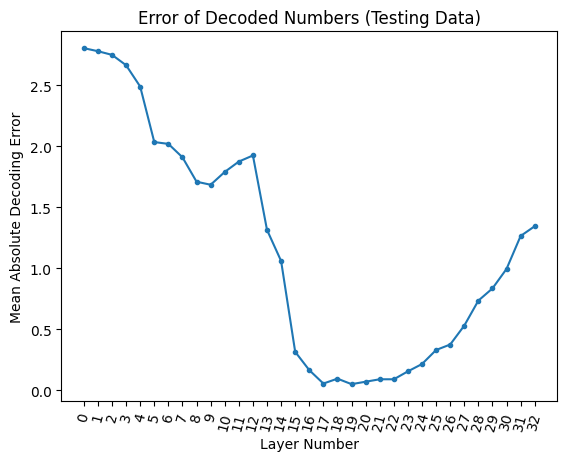

Minimum Error: 0.05 and problem type error: 0 at layer 19 , Current running loss: 0.01525726318359375


In [24]:
# Verbose testing

SP_predictions = []
label_SPs      = []
rows_to_print = 1
verbose = True
errors = np.zeros(len(layer_numbers))
lowest_error_layer = 0
lowest_error       = complexity + 1
lowest_pt_error    = np.inf
for n, layer in enumerate(layer_numbers):
    row_count = 0
    if layer.item() not in [16, 17]:
        pass
        #continue
    if verbose:
        print("--------- Layer", layer.item(), "---------")
    e = 0
    for batch_idx, (data, labels) in enumerate(testing_encoder_data_loaders[n]):
        pred = encoders[n](data)
        decoded_n1 = [sum([round(i, 0) * 10**n for n, i in enumerate(decode_digits(pred[i].type_as(vectors[SP_n1]), SP_n1))]) for i in range(pred.shape[0])]
        decoded_n2 = [sum([round(i, 0) * 10**n for n, i in enumerate(decode_digits(pred[i].type_as(vectors[SP_n2]), SP_n2))]) for i in range(pred.shape[0])]
        actual_n1 = [sum([round(i, 0) * 10**n for n, i in enumerate(decode_digits(labels[i].type_as(vectors[SP_n1]), SP_n1))]) for i in range(labels.shape[0])]
        actual_n2 = [sum([round(i, 0) * 10**n for n, i in enumerate(decode_digits(labels[i].type_as(vectors[SP_n2]), SP_n2))]) for i in range(labels.shape[0])]
        decoded_problem_types = decode_problem_type(pred)
        actual_problem_types  = decode_problem_type(labels)
        for r in range(rows_to_print):
            print("Decoded symbolic encodings: first number:",  decoded_n1[r], "second number:", decoded_n2[r])
            print("Actual           encodings: first number:",  actual_n1[r],  "second number:", actual_n2[r])
            print("Decoded problem type:", decoded_problem_types[r])
            print("Actual  problem type:", actual_problem_types[r])
            #print(" --------- Error:", decoded_n1[r]-actual_n1[r], decoded_n2[r]-actual_n2[r], )
        e += np.mean(digit_error(decoded_n1, actual_n1) + digit_error(decoded_n2, actual_n2)) * len(data) / len(testing_encoder_data)
        print("Average Error:", np.mean(e), "digits out of", complexity+1)
        problem_type_error = (decoded_problem_types != actual_problem_types).sum()
        print("Average Problem Type Error:", problem_type_error, "out of", len(labels))
    errors[n] = e
    if e < lowest_error:
        lowest_error_layer = layer
        lowest_error       = e
        lowest_pt_error    = problem_type_error

x_ticks = np.arange(layer_numbers[0].item(), layer_numbers[0].item() + len(layer_numbers), 1)  # Adjust the range as needed
plt.plot(x_ticks, errors, marker=".")
plt.xticks(x_ticks, rotation=75)
plt.title("Error of Decoded Numbers (Testing Data)")
plt.ylabel("Mean Absolute Decoding Error")
plt.xlabel("Layer Number")
plt.show()
print("Minimum Error:", lowest_error, "and problem type error:", problem_type_error, "at layer", lowest_error_layer.item(), ", Current running loss:", running_losses[lowest_error_layer.item()])

In [25]:
# Minimum Error: 0.06 and problem type error: 0 at layer 20 , Current running loss: 0.0166046142578125


# Minimum Error: 0.385 at layer 15 , Current running loss: 0.03180745442708333

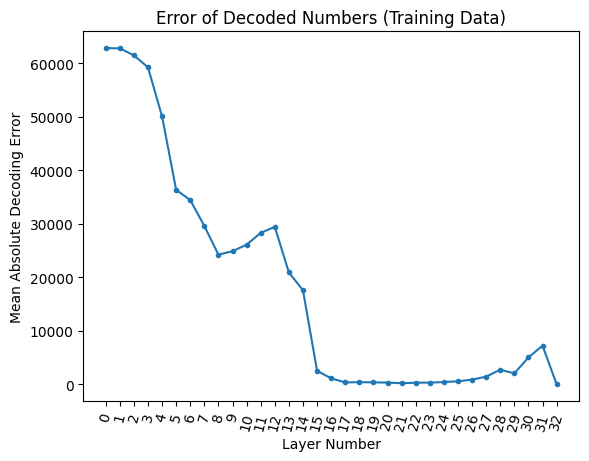

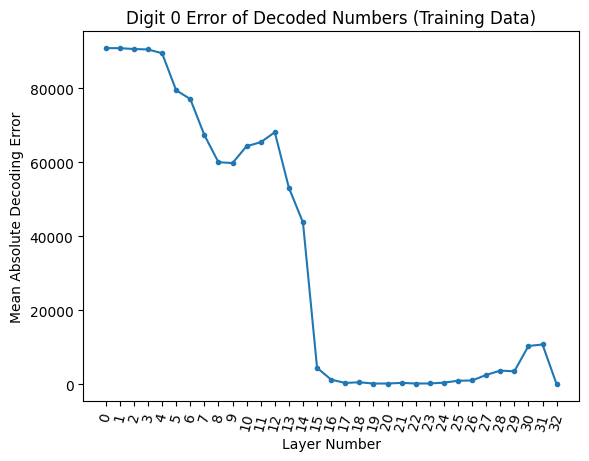

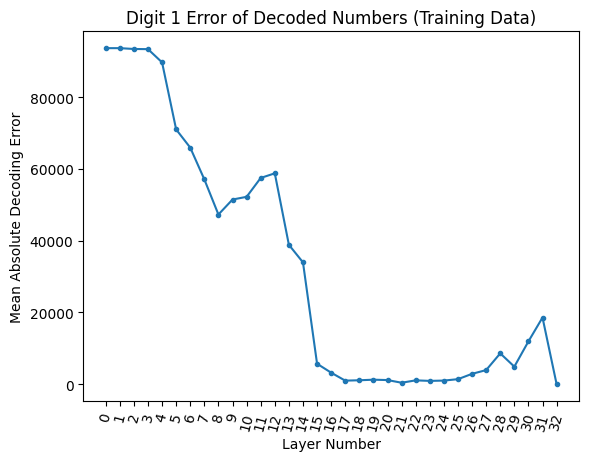

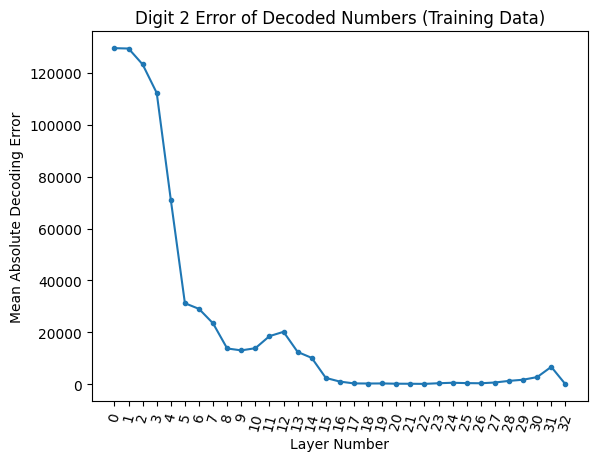

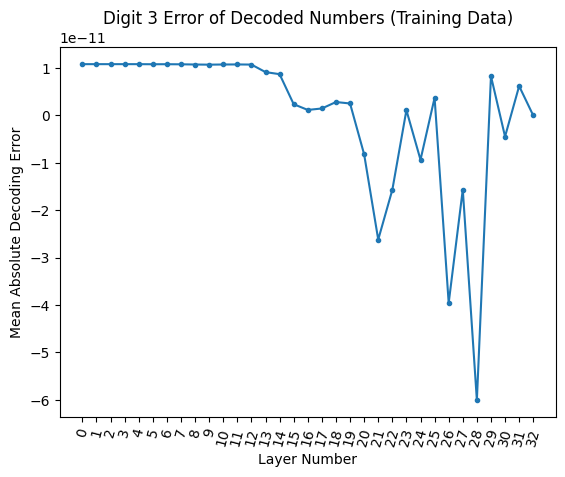

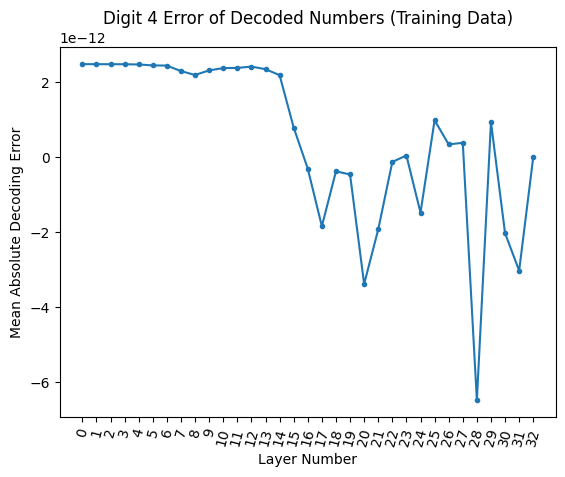

In [26]:
SP_predictions = []
label_SPs      = []
max_rows = 100
verbose = False
train_errors = torch.zeros((len(layer_numbers), len(digits)))
for n, layer in enumerate(layer_numbers):
    encoders[n] = encoders[n].to(device).eval()

with torch.no_grad():
    for n, layer in enumerate(layer_numbers):
        row_count = 0
        for batch_idx, (data, labels) in enumerate(encoder_data_loaders[n]):
            pred = encoders[n](data)
            SP_predictions += [pred]
            label_SPs += [labels]
            actual_digits_n1    = decode_digits_tensor(labels.to(torch.float32), SP_n1)
            actual_digits_n2    = decode_digits_tensor(labels.to(torch.float32), SP_n2)
            predicted_digits_n1 = decode_digits_tensor(pred.to(torch.float32), SP_n1)
            predicted_digits_n2 = decode_digits_tensor(pred.to(torch.float32), SP_n2)
            digit_errors = (actual_digits_n1-predicted_digits_n1).mean(axis=0)
            #print(digit_errors.mean().cpu().item())
            train_errors[n] += digit_errors.cpu() * len(data)
            row_count += len(data)
    train_errors[n] /= row_count

plt.plot(train_errors.mean(axis=1), marker=".")
x_ticks = np.arange(0, len(layer_numbers), 1)  # Adjust the range as needed
plt.xticks(x_ticks, rotation=75)
plt.title("Error of Decoded Numbers (Training Data)")
plt.ylabel("Mean Absolute Decoding Error")
plt.xlabel("Layer Number")
plt.show()

for n, d in enumerate(digits):
    plt.plot(train_errors[:,n], marker=".")
    x_ticks = np.arange(0, len(layer_numbers), 1)  # Adjust the range as needed
    plt.xticks(x_ticks, rotation=75)
    plt.title(f"Digit {n} Error of Decoded Numbers (Training Data)")
    plt.ylabel("Mean Absolute Decoding Error")
    plt.xlabel("Layer Number")
    plt.show()

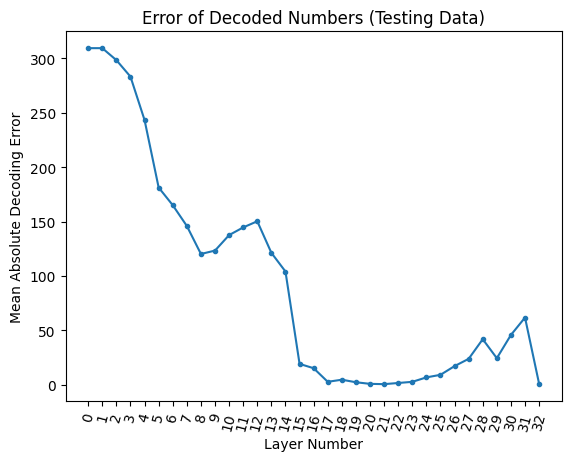

In [27]:
SP_predictions = []
label_SPs      = []
max_rows = 100
verbose = False
test_errors = torch.zeros((len(layer_numbers), len(digits)))
for n, layer in enumerate(layer_numbers):
    encoders[n] = encoders[n].to(device).eval()

with torch.no_grad():
    for n, layer in enumerate(layer_numbers):
        row_count = 0
        for batch_idx, (data, labels) in enumerate(testing_encoder_data_loaders[n]):
            pred = encoders[n](data)
            SP_predictions += [pred]
            label_SPs += [labels]
            actual_digits_n1    = decode_digits_tensor(labels.to(torch.float32), SP_n1)
            actual_digits_n2    = decode_digits_tensor(labels.to(torch.float32), SP_n2)
            predicted_digits_n1 = decode_digits_tensor(pred.to(torch.float32), SP_n1)
            predicted_digits_n2 = decode_digits_tensor(pred.to(torch.float32), SP_n2)
            digit_errors = (actual_digits_n1-predicted_digits_n1).mean(axis=0)
            #print(digit_errors.mean().cpu().item())
            test_errors[n] += digit_errors.cpu() * len(data)
            row_count += len(data)
    test_errors[n] /= row_count

plt.plot(test_errors.mean(axis=1), marker=".")
x_ticks = np.arange(0, len(layer_numbers), 1)  # Adjust the range as needed
plt.xticks(x_ticks, rotation=75)
plt.title("Error of Decoded Numbers (Testing Data)")
plt.ylabel("Mean Absolute Decoding Error")
plt.xlabel("Layer Number")
plt.show()


In [28]:
decoded_n1[r], actual_n1[r]

(970.0, 973.0)

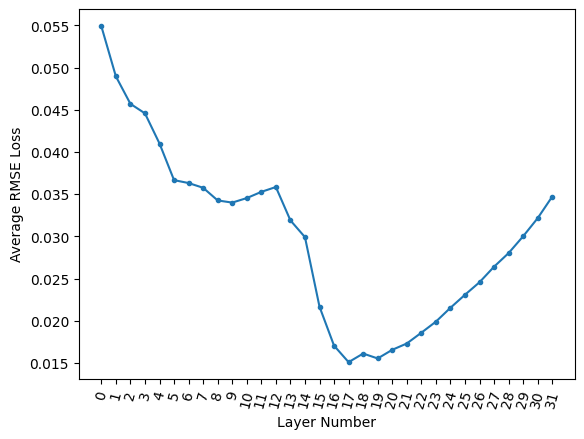

In [29]:
plt.plot(losses.T[:i].mean(axis=0)[:-1], marker=".")
x_ticks = np.arange(0, len(losses.T.mean(axis=0)[:-1]), 1)  # Adjust the range as needed
plt.xticks(x_ticks, rotation=75)
plt.ylabel("Average RMSE Loss")
plt.xlabel("Layer Number")
plt.show()

In [30]:
training_start = 2

tensor = losses[:,training_start:i]
x = np.arange(tensor.shape[0])
y = np.arange(tensor.shape[1])
X, Y = np.meshgrid(x, y)

# Transpose the tensor to match the meshgrid dimensions
Z = tensor.T  # Shape becomes (2000, 32)

# Create an interactive 3D surface plot
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='inferno')])

# Customize layout
fig.update_layout(
    title='Loss vs Layer Number and Training Epoch',
    scene=dict(
        xaxis_title='Layer Number',
        yaxis_title='Training Epoch',
        zaxis_title='Loss',
    ),
)

# Show the plot
fig.show()


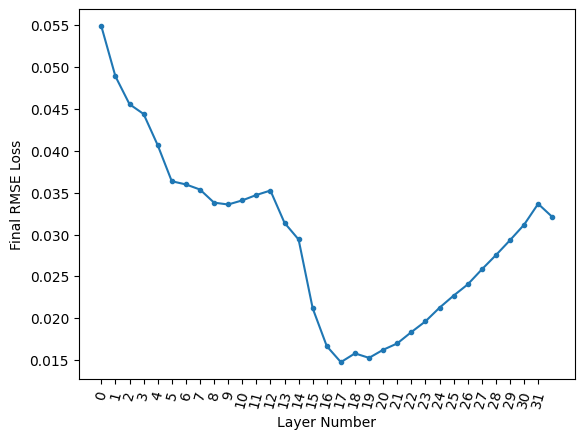

In [ ]:
plt.plot(losses.T[:i+1][-1,:], marker=".")
x_ticks = np.arange(0, len(losses.T.mean(axis=0)[:-1]), 1)  # Adjust the range as needed
plt.xticks(x_ticks, rotation=75)
plt.ylabel("Final RMSE Loss")
plt.xlabel("Layer Number")
plt.show()

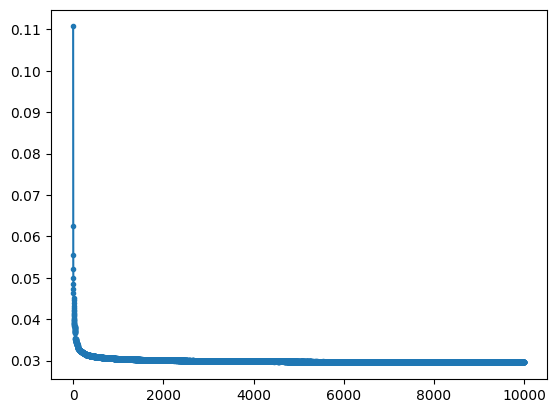

In [32]:
plt.plot(losses.mean(axis=0)[:i], marker=".")

In [33]:
for n, n_layer in enumerate(layer_numbers):
    for param in encoders[n].parameters():
        param.requires_grad = False

In [34]:
decoders = torch.nn.ModuleList()
for layer_id in layer_numbers:
    #layer_decoder = Decoder_Deep(layer_id, SP_dim, model_dim, model_dim*2).to(device)
    layer_decoder = Decoder(layer_id, SP_dim, model_dim).to(device)
    decoders.append(layer_decoder)#, dtype=torch.float32))


In [35]:
decoding_training_epochs = 1000
decoding_learning_rate = 1e-3 # Base learning rate, modified by learning_rate_reduction_factors
decoding_learning_rate_reduction_factors = {10: 0.1, 25:  0.5, 100: 0.5, 250: .4}


In [36]:
decoding_optimizers   = [optim.Adam(decoders[n].parameters(), lr=decoding_learning_rate) for n in range(len(layer_numbers))]
decoding_criterion = nn.MSELoss()
decoding_losses = np.zeros((len(layer_numbers), decoding_training_epochs))
decoding_running_losses = np.zeros((len(layer_numbers)))
for j in range(decoding_training_epochs):
    if j in decoding_learning_rate_reduction_factors.keys():
        for param_group in decoding_optimizers[n].param_groups:
            param_group['lr'] = param_group['lr'] * decoding_learning_rate_reduction_factors[j]  # Set new learning rate
            print("Learning Rate changed to:", param_group['lr'])
    if not j % 5 and j:
        print("Epoch:", j, "Running Loss:", decoding_running_losses.mean(), f"\tTotal gradient norm: {total_norm}")
    for n, n_layer in enumerate(layer_numbers):
        decoding_running_loss = 0
        total_norm = 0.0
        for batch_idx, (data, labels) in enumerate(encoder_data_loaders[n]):
            latent_representation = encoders[n](data)
            
            #std = torch.exp(0.5 * latent_logvar)  # Compute standard deviation
            #epsilon = torch.randn_like(std)      # Sample noise
            #latent_representation = latent_representation + epsilon

            predicted_hidden_state = decoders[n](latent_representation)            

            loss = torch.sqrt(criterion(predicted_hidden_state, data))
            loss.backward()
            tn = 0
            for p in decoders[n].parameters():
                if p.grad is not None:
                    param_norm = p.grad.data.norm(2)
                    tn += param_norm.item() ** 2
            total_norm += tn ** 0.5
            decoding_optimizers[n].step()
            decoding_optimizers[n].zero_grad()
            decoding_running_loss += loss.item()
        decoding_running_loss /= (batch_idx + 1)
        decoding_running_losses[n] = decoding_running_loss
        total_norm   /= (batch_idx + 1)
        decoding_losses[n][j] = decoding_running_loss


Epoch: 5 Running Loss: 0.1338013591188373 	Total gradient norm: 0.00624237060546875
Learning Rate changed to: 0.0001
Epoch: 10 Running Loss: 0.1302961985270182 	Total gradient norm: 0.0053070068359375
Epoch: 15 Running Loss: 0.1290766195817427 	Total gradient norm: 0.005265045166015625
Epoch: 20 Running Loss: 0.12813722437078304 	Total gradient norm: 0.005274200439453125
Learning Rate changed to: 5e-05
Epoch: 25 Running Loss: 0.12744074445782286 	Total gradient norm: 0.005278778076171875
Epoch: 30 Running Loss: 0.12687500462387546 	Total gradient norm: 0.005260467529296875
Epoch: 35 Running Loss: 0.12640016440189245 	Total gradient norm: 0.00527191162109375
Epoch: 40 Running Loss: 0.12602916486335522 	Total gradient norm: 0.005272674560546875
Epoch: 45 Running Loss: 0.12562227827129943 	Total gradient norm: 0.00527801513671875
Epoch: 50 Running Loss: 0.12530464114564838 	Total gradient norm: 0.005279541015625
Epoch: 55 Running Loss: 0.125121934486158 	Total gradient norm: 0.00526428222

Epoch: 475 Running Loss: 0.12171078161759812 	Total gradient norm: 0.00526123046875
Epoch: 480 Running Loss: 0.12162975325728906 	Total gradient norm: 0.005265045166015625
Epoch: 485 Running Loss: 0.12164235548539597 	Total gradient norm: 0.005268096923828125
Epoch: 490 Running Loss: 0.12164997910008286 	Total gradient norm: 0.0052642822265625
Epoch: 495 Running Loss: 0.12156137444756249 	Total gradient norm: 0.005268096923828125
Epoch: 500 Running Loss: 0.12161450530543472 	Total gradient norm: 0.0052764892578125
Epoch: 505 Running Loss: 0.12162187858061357 	Total gradient norm: 0.005271148681640625
Epoch: 510 Running Loss: 0.12160329349113236 	Total gradient norm: 0.005280303955078125
Epoch: 515 Running Loss: 0.12160947828581839 	Total gradient norm: 0.005275726318359375
Epoch: 520 Running Loss: 0.12159620415080677 	Total gradient norm: 0.0052734375
Epoch: 525 Running Loss: 0.12158412427613229 	Total gradient norm: 0.005275726318359375
Epoch: 530 Running Loss: 0.12165741017370514 	To

Epoch: 950 Running Loss: 0.12140890468250623 	Total gradient norm: 0.005269622802734375
Epoch: 955 Running Loss: 0.1214362939198812 	Total gradient norm: 0.005269622802734375
Epoch: 960 Running Loss: 0.12137182607795252 	Total gradient norm: 0.0052703857421875
Epoch: 965 Running Loss: 0.12133759260177612 	Total gradient norm: 0.00527191162109375
Epoch: 970 Running Loss: 0.12140948808554447 	Total gradient norm: 0.005261993408203125
Epoch: 975 Running Loss: 0.12139089685497861 	Total gradient norm: 0.0052703857421875
Epoch: 980 Running Loss: 0.12145305908087531 	Total gradient norm: 0.005260467529296875
Epoch: 985 Running Loss: 0.12139515949018073 	Total gradient norm: 0.00526885986328125
Epoch: 990 Running Loss: 0.12138231992721556 	Total gradient norm: 0.005266571044921875
Epoch: 995 Running Loss: 0.12138870376529115 	Total gradient norm: 0.005267333984375


In [37]:
training_start = 0

tensor = decoding_losses[:,training_start:j]
x = np.arange(tensor.shape[0])
y = np.arange(tensor.shape[1])
X, Y = np.meshgrid(x, y)

# Transpose the tensor to match the meshgrid dimensions
Z = tensor.T  # Shape becomes (2000, 32)

# Create an interactive 3D surface plot
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='inferno')])

# Customize layout
fig.update_layout(
    title='Loss vs Layer Number and Training Epoch',
    scene=dict(
        xaxis_title='Layer Number',
        yaxis_title='Training Epoch',
        zaxis_title='Loss',
    ),
)

# Show the plot
fig.show()


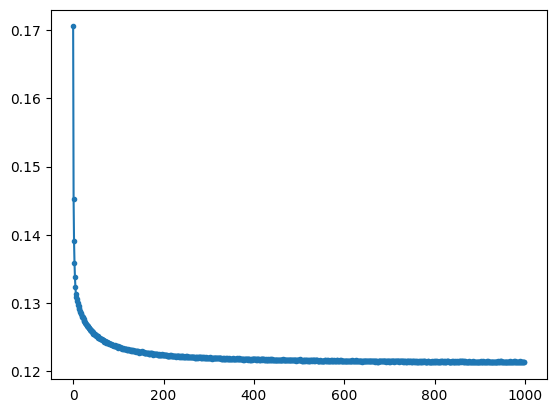

In [38]:
plt.plot(decoding_losses.mean(axis=0)[:j], marker=".")

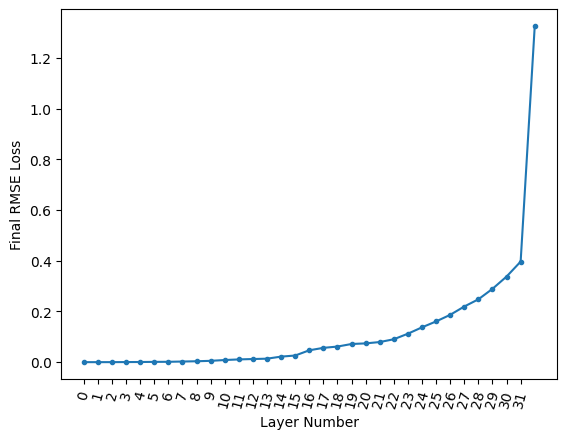

In [39]:
plt.plot(decoding_losses.T[:j+1][-1,:], marker=".")
x_ticks = np.arange(0, len(decoding_losses.T.mean(axis=0)[:-1]), 1)  # Adjust the range as needed
plt.xticks(x_ticks, rotation=75)
plt.ylabel("Final RMSE Loss")
plt.xlabel("Layer Number")
plt.show()

In [ ]:
torch.save(encoders.state_dict(), "encoders_state_dict_20241221.pth")
torch.save(decoders.state_dict(), "decoders_state_dict_20241221.pth")
torch.save(encoders, "encoders_20241221.pth")
torch.save(decoders, "decoders_20241221.pth")